In [149]:
import nltk
import numpy as np
import pandas as pd
import igraph as ig
import leidenalg as la
from collections import Counter
from functools import reduce
from wordcloud import WordCloud, STOPWORDS

# import help function
import SN_help
import importlib
importlib.reload(SN_help) # reload package
from SN_help import build_bipartite, draw_degree_distributions_bar, draw_degree_dist_timely, draw_shortest_path_length_hist,\
                    get_summary, get_first_last, animate_degree_dist_yearly, get_centralities, get_top_centrality_movies,\
                    centralities_correlation, attribute_with_centralities, get_nominal, add_money_attribute,\
                    plot_3d_graph, plot_2d_graph, plot_3d_communities, get_TFIDF ,\
                    add_numerical_attribute, Happy_Hedonometer, plot_hap_dist_for_attr, \
                    list_add, plot_mean_dist_for_attr_x, plot_mean_dist_for_attr_y, boxplot_for_perumtation,\
                    cloudplot_for_perumtation, plot_hap_dist_for_community, plot_mean_dist_for_community_x,\
                    plot_mean_dist_for_community_y, boxplot_for_perumtation_community, get_attr_hap, get_comm_hap,\
                    ttest_ind_fun, add_edge_attr, set_fig_info, get_max_degree_timely, get_ba_er_params, draw_gamma_maxk_len_overtime


# Netflix Movie Network

1. Build Netflix movie-actor netowrk
2. Download movies' plot, keywords, synopsis
3. Add attributes
4. Basic data analysis

## Permutation test for IMDB and Netflix

IMDB

In [121]:
movie_path = './imdb/movie_basic.parquet'
actor_path = './imdb/actor_basic.parquet'
link_path = './imdb/movie_actor_basic.parquet'
save_path = './imdb/network'
tag = 'imdb'
imdb_g, _, imdb_mg, _ = build_bipartite(movie_path, actor_path, link_path)

>>>> Adding 627833 movies and 426018 actors to network.
>>>> Adding 1213746 movie-actor links to network.
>>>> Projecting bipartite nework to movie nodes and actor nodes.
>>>> Cleanning useless attributes for Movie Network.
		['bipartite', 'birthYear', 'deathYear', 'nconst', 'primaryName']
>>>> Cleanning useless attributes for Actor Network.
		['bipartite', 'description', 'genres', 'averageRating', 'numVotes', 'primaryTitle', 'runtimeMinutes', 'startYear', 'tconst']
		There is no description attribute, pass
>>>> Getting the GCC of Movie Network and Actor Network.
		Movie: (N627833, L16230951)-->(N362943, L16206831)
		Actor: (N426018, L1268202)-->(N274067, L1091586)
>>>> Saving to ./imdb/network/imdb.movie.ig.pickle and ./imdb/network/imdb.actor.ig.pickle
>>>> Summary:
IGRAPH U-W- 627833 16230951 -- 
+ attr: averageRating (v), genres (v), numVotes (v), primaryTitle (v), runtimeMinutes (v), startYear (v), tconst (v), weight (e)
IGRAPH U-W- 426018 1268202 -- 
+ attr: birthYear (v), deathY

Netflix

In [61]:
movie_path = './netflix/movie.parquet'
actor_path = './netflix/actor.parquet'
link_path = './netflix/movie_actor.parquet'
save_path = './netflix/network'
tag = 'netflix'
mg, _, mgcc, _ = build_bipartite(movie_path, actor_path, link_path)

>>>> Adding 4129 movies and 6021 actors to network.
>>>> Adding 9239 movie-actor links to network.
>>>> Projecting bipartite nework to movie nodes and actor nodes.
>>>> Cleanning useless attributes for Movie Network.
		['bipartite', 'birthYear', 'deathYear', 'nconst', 'primaryName']
>>>> Cleanning useless attributes for Actor Network.
		['bipartite', 'description', 'genres', 'averageRating', 'numVotes', 'primaryTitle', 'runtimeMinutes', 'startYear', 'tconst']
>>>> Getting the GCC of Movie Network and Actor Network.
		Movie: (N4129, L9076)-->(N1923, L8346)
		Actor: (N6021, L8686)-->(N2392, L4676)
>>>> Summary:
IGRAPH U-W- 4129 9076 -- 
+ attr: averageRating (v), country (v), description (v), genres (v), numVotes (v), primaryTitle (v), runtimeMinutes (v), startYear (v), tconst (v), weight (e)
IGRAPH U-W- 6021 8686 -- 
+ attr: birthYear (v), country (v), deathYear (v), nconst (v), primaryName (v), weight (e)
>>>> Done !


**Does Netflix share the same distribution with IMDB**

  0%|          | 0/2000 [00:00<?, ?it/s]

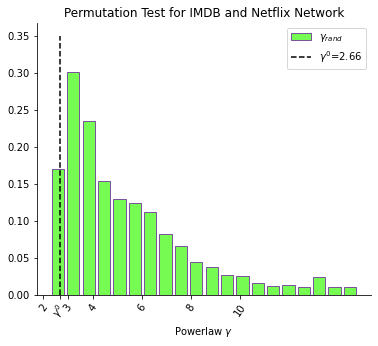

In [118]:
import powerlaw
from tqdm.notebook import trange
from scipy.stats import permutation_test

gamma_nfx = powerlaw.Fit(mg.degree(), discrete=True, verbose=False).alpha
gamma_rand=[]
for i in trange(2000):
    nodes_rand = np.random.choice(imdb_mg.vs, 4129)
    g_rand = imdb_mg.subgraph(nodes_rand)
    gamma = powerlaw.Fit(g_rand.degree(), discrete=True, verbose=False).alpha
    gamma_rand.append(gamma)

plt.figure(figsize=(6, 5))
plt.title('Permutation Test for IMDB and Netflix Network')
plt.hist(gamma_rand, bins=20, density=True, rwidth=0.8, color='#75fb52', edgecolor='#7b549b', label='$\gamma_{rand}$')
plt.plot([gamma_nfx, gamma_nfx], [0, 0.35], '--', color='black', label=f'$\gamma^0$={gamma_nfx:.2f}')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.xlabel('Powerlaw $\gamma$')
xt = [2, 3, 4, 6, 8, 10, gamma_nfx]
xtl = ['2', '3', '4', '6', '8', '10', '$\gamma^0$']
plt.xticks(xt, xtl, rotation=55)
plt.legend()
plt.show()

In [123]:
powerlaw.Fit(imdb_mg.degree(), discrete=True, verbose=False).alpha, powerlaw.Fit(imdb_g.degree(), discrete=True, verbose=False).alpha

(5.053434486335963, 5.053434486335963)

**Dose giant connected component share the same distribution with full network**

  0%|          | 0/2000 [00:00<?, ?it/s]

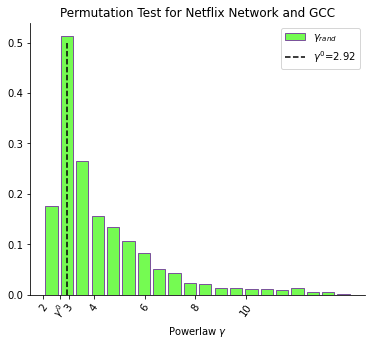

In [117]:
gamma_gcc = powerlaw.Fit(mgcc.degree(), discrete=True, verbose=False).alpha
gamma_rand=[]
for i in trange(2000):
    nodes_rand = np.random.choice(mg.vs, 1923)
    g_rand = mg.subgraph(nodes_rand)
    gamma = powerlaw.Fit(g_rand.degree(), discrete=True, verbose=False).alpha
    gamma_rand.append(gamma)

plt.figure(figsize=(6, 5))
plt.title('Permutation Test for Netflix Network and GCC')
plt.hist(gamma_rand, bins=20, density=True, rwidth=0.8, color='#75fb52', edgecolor='#7b549b', label='$\gamma_{rand}$')
plt.plot([gamma_gcc, gamma_gcc], [0, 0.5], '--', color='black', label=f'$\gamma^0$={gamma_gcc:.2f}')
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.xlabel('Powerlaw $\gamma$')
xt = [2, 3, 4, 6, 8, 10, gamma_nfx]
xtl = ['2', '3', '4', '6', '8', '10', '$\gamma^0$']
plt.xticks(xt, xtl, rotation=55)
plt.legend()
plt.show()

In [125]:
powerlaw.Fit(mg.degree(), discrete=True, verbose=False).alpha, powerlaw.Fit(mgcc.degree(), discrete=True, verbose=False).alpha

(2.6583250163995196, 2.9185024791961847)

## Grab extra attributes and other document sources from IMDB network

1. Download `box office`, `budject` for movies, `birth` information for actors.
2. Download document/text sources from IMDB. 
    - For movies, every movies will get `outline`, `plot`, `synopsis`, `keyword`, `review`, `describe`.
    - For actors, every actor will get `mini bigoraphy`, `trivia`.
    - Then, according to the labMT dictionary, the sentiment values of each node corresponding to the text type, once been calculated, will be assgined as movie attributes as well.
3. In the subsequent operation, we will also add the node properties, such as `community` and `centrality`, to network as nodes' attributes to facilitate analysis

In [3]:
# Download text information, movie plot keywords synopsis 
# m_attr = SN_help.movie_downloader(mgcc)          # movie plot synopsis
# m_keyword = SN_help.keywords_downloader(mgcc)    # movie keywords
# m_review = SN_help.reviews_downloader(mgcc)      # movie reviews
# a_attr = SN_help.actor_downloader(agcc)          # actor biography trivia


In [4]:
labels = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']

m_attr = pd.read_csv('./netflix/download/movie.attr.csv', index_col=0)          # movie plot synopsis
m_keyword = pd.read_csv('./netflix/download/movie.keyword.csv', index_col=0)    # movie keywords
m_review = pd.read_csv('./netflix/download/movie.review.csv', index_col=0)      # movie reviews
m_describe = pd.read_parquet('./netflix/movie.parquet').set_index('tconst')

outline = m_attr.plotOutline.fillna('')
plot = m_attr.loc[:,'plot'].fillna('')
synopsis = m_attr.synopsis.fillna('')
keyword = m_keyword.keywords.fillna('')
review = m_review.reviews.fillna('')
describe = m_describe.loc[review.index].description.fillna('')

text_material = [outline, plot, synopsis, keyword, review, describe] 

## Add sentiment values and financial values

- Sentiment attributte
    > We found that ALL the document types all have a lower average sentiment valuse than neutral 5, and Movie keyword has highest sentiment variance (0.986329), but Movie review has lowest sentiment variance (0.282609). 
    > This is largely in line with our expectations. The film's keywords are very concise and are basically words with very strong emotional overtones. We downloaded only the popular reviews, many of which are very fair, and one review will not only say the good things about the movie but also analyze the shortcomings of the movie.
    > The former data is more jittery, the latter data is more balanced.

- Financial attributte
    > There are errors in the accounting data because some films are counted in US dollars and some in other currencies. Luckily, the majority are US dollar.

In [5]:
hap_meter = Happy_Hedonometer(delta=1, path='Data_Set_S1.txt')
display(hap_meter.LabMT.head(5))

text_material = [outline, plot, synopsis, keyword, review, describe] 
haps = []
for text_series in text_material:
    haps.append(text_series.apply(hap_meter))

# write it to graph attribute
hap_keys = ['hap_outline', 'hap_plot', 'hap_synopsis', 'hap_keyword', 'hap_review', 'hap_describe']
hap_titles=['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']
for key, hap in zip(hap_keys, haps):
    add_numerical_attribute(mg, hap, key)
    
haps_summary = pd.DataFrame(columns=hap_titles)
for i, hap in enumerate(haps):
    haps_summary.iloc[:, i] = hap.describe()
haps_summary

,word,happiness_rank,happiness_average,happiness_standard_deviation,twitter_rank,google_rank,nyt_rank,lyrics_rank
0,laughter,1,8.50,0.9313,3600,--,--,1728
1,happiness,2,8.44,0.9723,1853,2458,--,1230
2,love,3,8.42,1.1082,25,317,328,23
3,happy,4,8.30,0.9949,65,1372,1313,375
4,laughed,5,8.26,1.1572,3334,3542,--,2332


,Movie plot outlines,Movie plots,Movie synopsis,Movie keywords,Movie reviews,Netflix Description
count,1628.000000,1918.000000,930.000000,1834.000000,1892.000000,1923.000000
mean,4.100989,4.222440,4.020640,4.367986,4.459886,4.098904
std,0.612063,0.869094,0.501581,0.986329,0.282609,0.814184
min,1.978065,1.100000,2.011618,0.740000,3.325590,1.571429
25%,3.671827,3.659118,3.689225,3.819650,4.283353,3.547560
50%,4.092577,4.226424,4.019557,4.176311,4.458642,4.084615
75%,4.537038,4.826429,4.343226,4.648746,4.632831,4.666857
max,6.156667,7.252000,7.710000,8.420000,6.053846,6.890000


In [6]:
add_money_attribute(mg, m_attr, 'budget')
add_money_attribute(mg, m_attr, 'boxOffice')

## Overview of Movie Network

| Network Attribute                                                                      | Describtion                                            | Type       |
|----------------------------------------------------------------------------------------|--------------------------------------------------------|------------|
| tconst                                                                                 | IMDB ID                                                | string     |
| primaryTitle                                                                           | Movie Title                                            | string     |
| country                                                                                | Country list                                           | list       |
| genres                                                                                 | Genre list                                             | list       |
| startYear                                                                              | Release Date                                           | int year   |
| runtimeMinutes                                                                         | Movie Duration                                         | int minute |
| averageRating                                                                          | IMDB Rating                                            | float 0-10 |
| numVotes                                                                               | Rating users                                           | int        |
| budget                                                                                 | Movie Budget                                           | int       |
| boxOffice                                                                              | Box Office                                             | int       |
| 'hap_outline', 'hap_plot', 'hap_synopsis', 'hap_keyword', 'hap_review', 'hap_describe' | Sentiment values corresponding to different text types | float 1-9  |
| 'dg', 'cn', 'bt', 'ev'                                                                 | Centralities for degree, clossness, betweenness, eigenvector | float |


In [7]:
mN, mL = len(mg.vs), len(mg.es)
density = mg.density()
print(f'Nodes: {mN}\nLinks: {mL}\nDensity: {density}')
print(mg.summary())

Nodes: 4129
Links: 9076
Density: 0.0010649762222585193
IGRAPH U-W- 4129 9076 -- 
+ attr: averageRating (v), boxOffice (v), budget (v), country (v), description (v), genres (v), hap_describe (v), hap_keyword (v), hap_outline (v), hap_plot (v), hap_review (v), hap_synopsis (v), numVotes (v), primaryTitle (v), runtimeMinutes (v), startYear (v), tconst (v), weight (e)


## Basic Data Analysis

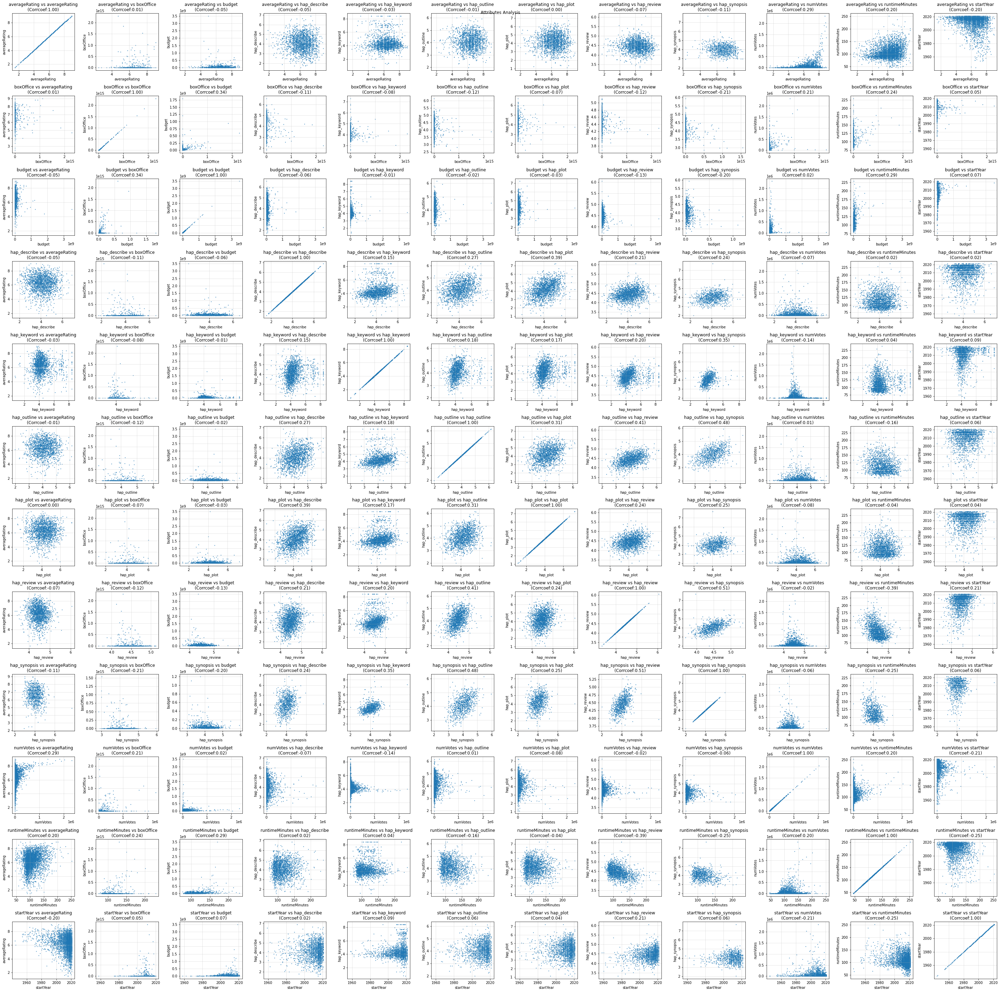

In [8]:
import matplotlib.pyplot as plt
def corss_attribute_analysis(g, key0, key1, temp, ax=None, threshold=0.2):
    if ax == None:
        ax = plt.subplot(1,1,1)
    attr0 = np.array(g.vs[key0])
    attr1 = np.array(g.vs[key1])
    attrs = pd.DataFrame(np.vstack((attr0, attr1))).T.dropna()
    ax.scatter(attrs.iloc[:,0], attrs.iloc[:,1], s=1)
    corrcoef = np.corrcoef(attrs.values.T.astype('float'))[0, -1]
    if key0 > key1 and np.abs(corrcoef)>threshold:
        # print(f'{key0:<14} ~ {key1:<14} : {corrcoef}')
        temp.append([key0, key1, corrcoef])
    ax.set_xlabel(key0)
    ax.set_ylabel(key1)
    ax.set_title(f'{key0} vs {key1}\n(Corrcoef:{corrcoef:.2f})')
    ax.grid(alpha=0.4)
    return ax

xi, yi = np.mgrid[0:12, 0:12]
keys = ['averageRating', 'boxOffice', 'budget', 'hap_describe', 'hap_keyword', 'hap_outline', 
        'hap_plot', 'hap_review', 'hap_synopsis', 'numVotes', 'runtimeMinutes', 'startYear']
temp = []
fig, axes = plt.subplots(12, 12, figsize=(40, 40))
for idx, ax in np.ndenumerate(axes):
    key0 = keys[xi[idx]]
    key1 = keys[yi[idx]]
    corss_attribute_analysis(mg, key0, key1, temp, ax, 0.3)
plt.suptitle('Attributes Analysis')
plt.tight_layout()
plt.show()

,0,1,2
0,budget,boxOffice,0.339399
1,hap_plot,hap_describe,0.387793
2,hap_plot,hap_outline,0.309441
3,hap_review,hap_outline,0.411176
4,hap_synopsis,hap_keyword,0.345081
5,hap_synopsis,hap_outline,0.477277
6,hap_synopsis,hap_review,0.507453
7,runtimeMinutes,hap_review,-0.386793


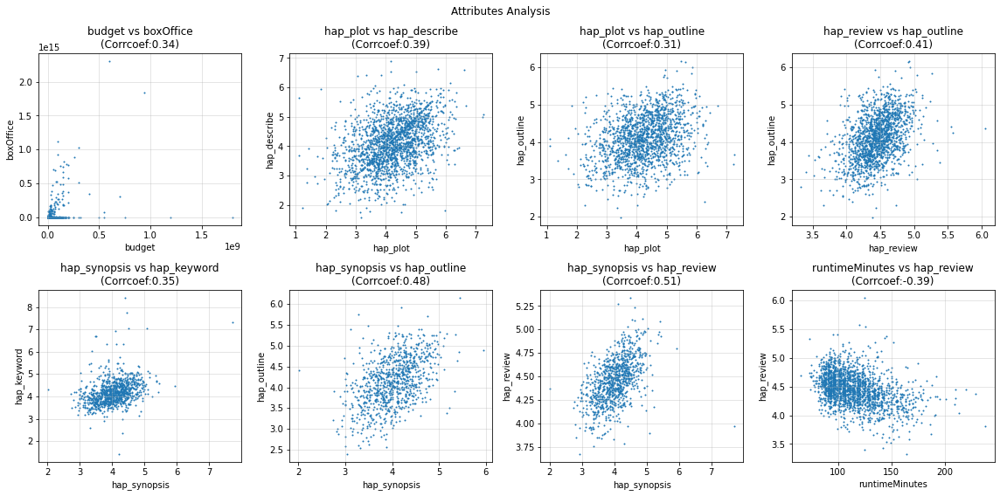

In [9]:
high_corrcoef = pd.DataFrame(temp)
display(high_corrcoef)
fig, axes = plt.subplots(2, 4, figsize=(16, 8))
for (i,j), ax in np.ndenumerate(axes):
    key0 = high_corrcoef.iloc[i*4+j][0]
    key1 = high_corrcoef.iloc[i*4+j][1]
    corss_attribute_analysis(mg, key0, key1, temp, ax, 0.3)
plt.suptitle('Attributes Analysis')
plt.tight_layout()
plt.show()

Those scatter figures show that there are a connection between the Box Office and Budget, and sentiment values from different document type have relative positive pearson coefficients, but Runtime has a negative correlation coefficient with sentimental value for reviews.

# Scale-Free Properities

## Degree Distribution

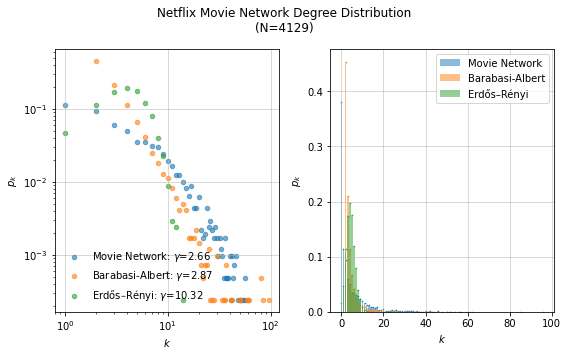

In [10]:
tags = ['Movie Network', 'Barabasi-Albert', 'Erdős–Rényi']
ba = ig.Graph.Barabasi(mN, 2) # fine-tuning the number of outgoing edges(2), to generate a barabasi albert graph with similar links to our movie network
er = ig.Graph.Erdos_Renyi(n=mN, p=2*mL/mN/(mN-1), directed=False, loops=False)  # fix N and L or fix N and p
gammas = draw_degree_distributions_bar([mg, ba, er], tags, 'Netflix', 20)

## Shortest-path-length Distribution

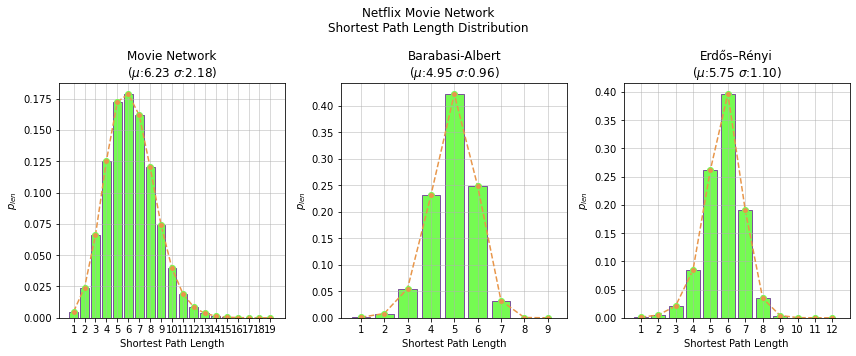

In [11]:
mus = draw_shortest_path_length_hist([mg, ba, er], tags, 'Netflix Movie Network')        

## Evolution

NOT all the nodes have release time, so the analysis below is inaccurate, but we still can observe a stable $\gamma$ around 2.9

### Network parameters' evolution over time

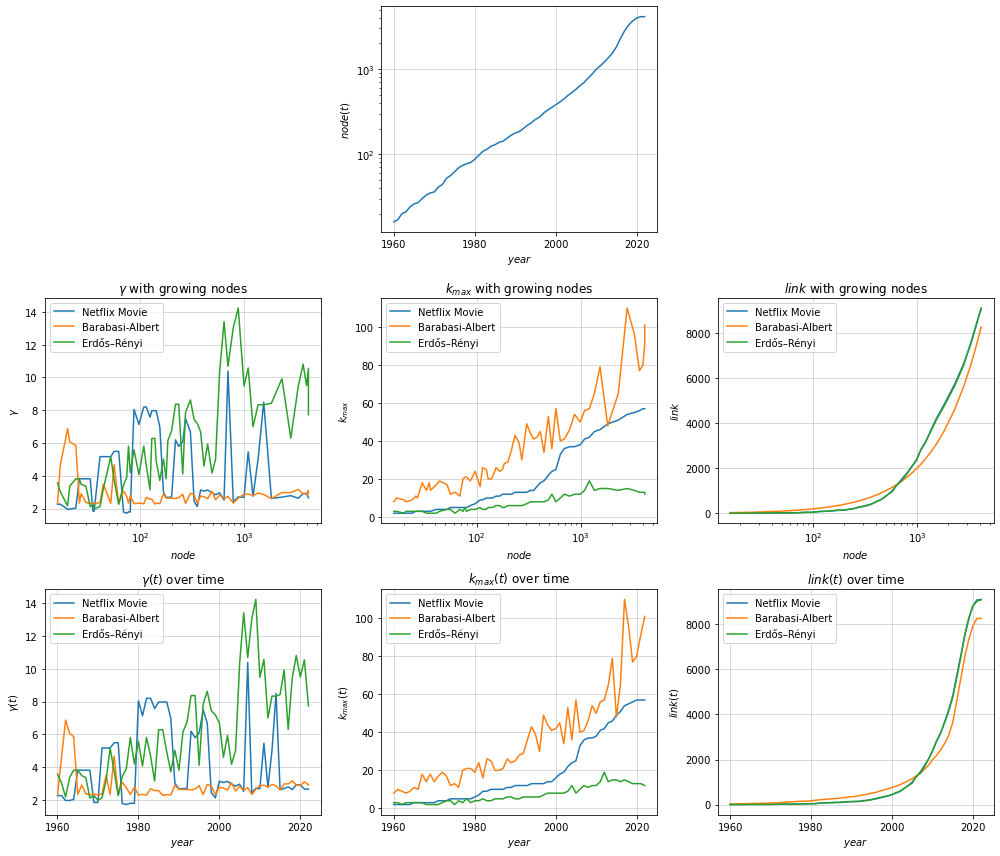

In [150]:
years = range(1960,2023)
params_mg = []
for year in years:
    gamma, k_max, l, n = get_max_degree_timely(mg, year)
    params_mg.append([gamma, k_max, l, n])
params_mg = np.array(params_mg)
params_ba, params_er = get_ba_er_params(params_mg[:,3], params_mg[:,2])
params = [params_mg, params_ba, params_er]
draw_gamma_maxk_len_overtime(params, years)

### Degree Distribution Overtime

The first movie in our network is Tunisian Victory in 1944, and the newest is Awake, released in 2021


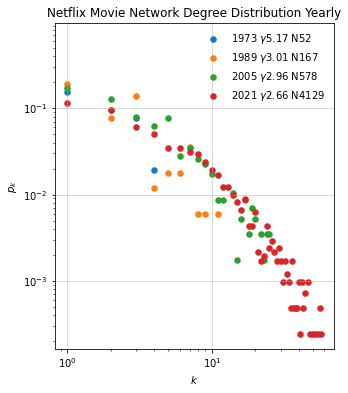

In [12]:
%matplotlib inline
startYear, endYear = get_first_last(mg, key='startYear', title='primaryTitle')

years = [1973, 1989, 2005, 2021]
draw_degree_dist_timely(mg, years, 'startYear', 'Netflix Movie Network', s=30)

animate_degree_dist_yearly(mg, 150, 1e-4, 1960, 2021, 'startYear', 'Netflix Movies')

### Degree Overtime for given nodes

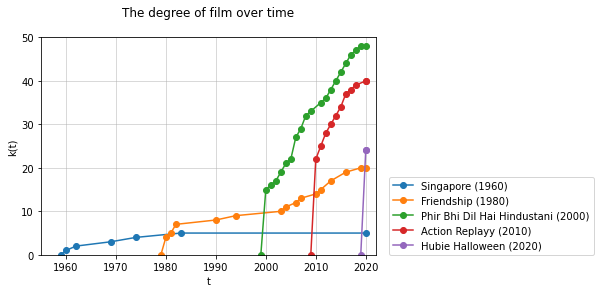

In [13]:
add_edge_attr(mg, 'startYear', 'year')
# example nodes

example_movies = ['Singapore', 'Friendship', 'Phir Bhi Dil Hai Hindustani', 'Action Replayy', 'Hubie Halloween']
release_year = []
for m in example_movies:
    node = mg.vs(primaryTitle_eq=m)[0]
    year = node['startYear']
    e = node.all_edges()[0]
    time_line = sorted([e['year'] for e in node.all_edges()])
    time_count = Counter(time_line)
    xs = list(time_count.keys())
    xs = [node['startYear']-1] + xs + [2020]
    ys = list(np.cumsum(list(time_count.values())))
    ys = [0] + ys + [ys[-1]]
    plt.plot(xs, ys, '-o', label=f'{m} ({year})')
plt.xlabel('t')
plt.ylabel('k(t)')
plt.xlim(1955, 2022)
plt.ylim(0, 50)
plt.title('The degree of film over time\n')
plt.grid(alpha=0.6)
plt.legend(loc=[1.04,0])
plt.show()

From figure above, The later movie joined the network has more change to become a hub.

## Scale-free Indicator summary

In [14]:
# we fine-tuned the barabasi albert model with its attached link m = 2 (≤ m0) to make the three graph comparable
get_summary([mg, ba, er], gammas, mus, tags)

,Network,N,L,⟨k⟩,⟨k²⟩,σ,γ,⟨d⟩,Diameter,Density
0,Movie Network,4129,9076,4.396222,68.863163,7.038210,2.658325,6.229195,19,0.001065
1,Barabasi-Albert,4129,8255,3.998547,37.838702,4.674433,2.872238,4.945445,9,0.000969
2,Erdős–Rényi,4129,9116,4.415597,23.849843,2.086228,10.321116,5.754472,12,0.001070


# Centrality

- `dg` is short degree centrality
- `cn` is short clossness centrality
- `bt` is short betweenness centrality
- `ev` is short eigenvector centrality

*This part we add centrality to graph as node attributes after we caluate it.

- `Degree Centrality`: *Important nodes will have a much higher degree*

    $C_{d e g}(v)=\frac{d_v}{|N|-1}$, where $N$ is the set of nodes in the network and $d_v$ is the degree of node $v$.
    

- `Clossness Centrality`: *Important nodes will be closer to other nodes*

    $C_{\text {close }}(v)=\frac{|N|-1}{\sum_{u \in N \backslash\{v\}} d(v, u)}$, where
    $N=$ set of nodes in the network,
    $d(v, u)=$ length of shortest path from $v$ to $u$.

- `Betweenness Centrality`: *Important nodes will have many shortest paths that pass through*

    $C_{b t w}(v)=\sum_{s, t \in N} \frac{\sigma_{s, t}(v)_o}{\sigma_{s, t}}$, where
    $\sigma_{s, t}=$ the number of shortest paths between nodes $s$ and $t$.
    $\sigma_{s, t}(v)=$ the number shortest paths between nodes $s$ and $t$ that pass through node $v$.
    
- `Eigenvector Centrality`: **

    Google's `PageRank` and `Katz` centrality are variants of Eigenvector centrality.

## Top centrality nodes

In [15]:
# caluate different centralites for movie network and add the value as attributes to our graph, make life easier.
get_centralities(mg, inplace=True)

**Movies with higest degree centrality**

In [16]:
get_top_centrality_movies(mg, 5, ['tconst', 'primaryTitle', 'country', 'genres', 'startYear', 'runtimeMinutes', 'averageRating'], centrality='dg')

,tconst,primaryTitle,country,genres,startYear,runtimeMinutes,averageRating,dg
0,tt2377938,Special 26,[India],"[Crime, Drama, Thriller]",2013,144.0,8.0,57
1,tt0172234,Chaahat,[India],"[Drama, Romance]",1996,151.0,5.5,56
2,tt0451850,Paheli,[India],"[Comedy, Drama, Fantasy]",2005,140.0,6.3,56
3,tt0449999,Kabhi Alvida Naa Kehna,[India],"[Drama, Romance]",2006,193.0,6.0,54
4,tt0456481,Jaan-E-Mann: Let's Fall in Love... Again,[India],"[Comedy, Drama, Musical]",2006,165.0,6.1,52
5,tt0438875,Insan,[India],"[Action, Crime, Drama]",2005,141.0,4.6,50


**Movies with higest clossness centrality**

In [17]:
get_top_centrality_movies(mg, 1, ['tconst', 'primaryTitle', 'country', 'genres', 'startYear', 'runtimeMinutes', 'averageRating'], centrality='cn')

,tconst,primaryTitle,country,genres,startYear,runtimeMinutes,averageRating,cn
0,tt0050817,Scandal in Sorrento,"[Italy, France]","[Comedy, Romance]",1955,110.0,6.5,1.0
1,tt0046292,The Sign of Venus,[Italy],"[Comedy, Drama, Romance]",1955,97.0,6.5,1.0
2,tt0049223,Forbidden Planet,[United States],"[Adventure, Sci-Fi]",1956,98.0,7.5,1.0
3,tt0071512,The Flying Guillotine,[Hong Kong],"[Action, Drama]",1975,105.0,6.6,1.0
4,tt0159510,Mobile Suit Gundam II: Soldiers of Sorrow,None,"[Action, Animation, Drama]",1981,139.0,7.2,1.0
...,...,...,...,...,...,...,...,...
296,tt15250998,Ankahi Kahaniya,None,"[Drama, Romance]",2021,110.0,5.5,1.0
297,tt14315566,Bartkowiak,[Poland],"[Action, Crime, Sport]",2021,91.0,5.1,1.0
298,tt10307724,Madame Claude,[France],"[Biography, Crime, Drama]",2021,112.0,5.4,1.0
299,tt9205538,Je Suis Karl,"[Germany, Czech Republic]","[Drama, Romance, Thriller]",2021,126.0,5.5,1.0


**Movies with higest between centrality**

In [18]:
get_top_centrality_movies(mg, 5, ['tconst', 'primaryTitle', 'country', 'genres', 'startYear', 'runtimeMinutes', 'averageRating'], centrality='bt')

,tconst,primaryTitle,country,genres,startYear,runtimeMinutes,averageRating,bt
0,tt1718924,A Family Man,"[Canada, United States]",[Drama],2016,108.0,6.5,392322.237699
1,tt0087469,Indiana Jones and the Temple of Doom,[United States],"[Action, Adventure]",1984,118.0,7.5,349434.780518
2,tt2302755,Olympus Has Fallen,[United States],"[Action, Thriller]",2013,119.0,6.5,195142.537636
3,tt2377938,Special 26,[India],"[Crime, Drama, Thriller]",2013,144.0,8.0,88648.920628
4,tt0109444,Clear and Present Danger,"[United States, Mexico]","[Action, Crime, Drama]",1994,141.0,6.9,87186.176552


**Movies with higest eigenvector centrality**

In [19]:
get_top_centrality_movies(mg, 5, ['tconst', 'primaryTitle', 'country', 'genres', 'startYear', 'runtimeMinutes', 'averageRating'], centrality='ev')

,tconst,primaryTitle,country,genres,startYear,runtimeMinutes,averageRating,ev
0,tt0451850,Paheli,[India],"[Comedy, Drama, Fantasy]",2005,140.0,6.3,1.000000
1,tt0172234,Chaahat,[India],"[Drama, Romance]",1996,151.0,5.5,1.000000
2,tt0222270,Phir Bhi Dil Hai Hindustani,[India],"[Comedy, Drama, Musical]",2000,160.0,6.1,0.908583
3,tt0114031,Oh Darling Yeh Hai India,[India],[Comedy],1995,160.0,4.0,0.890552
4,tt0449999,Kabhi Alvida Naa Kehna,[India],"[Drama, Romance]",2006,193.0,6.0,0.853966


## Correlation between different Centralities**
<a id='centralities_corrcoef'></a>

From the figure [`Correlation between different centralities`](#centralities_corrcoef), we can found that, there is a strong positive correlation between Eigenvector centrality and Degree centrality, while remaining centralities all exist a weak correlation. 

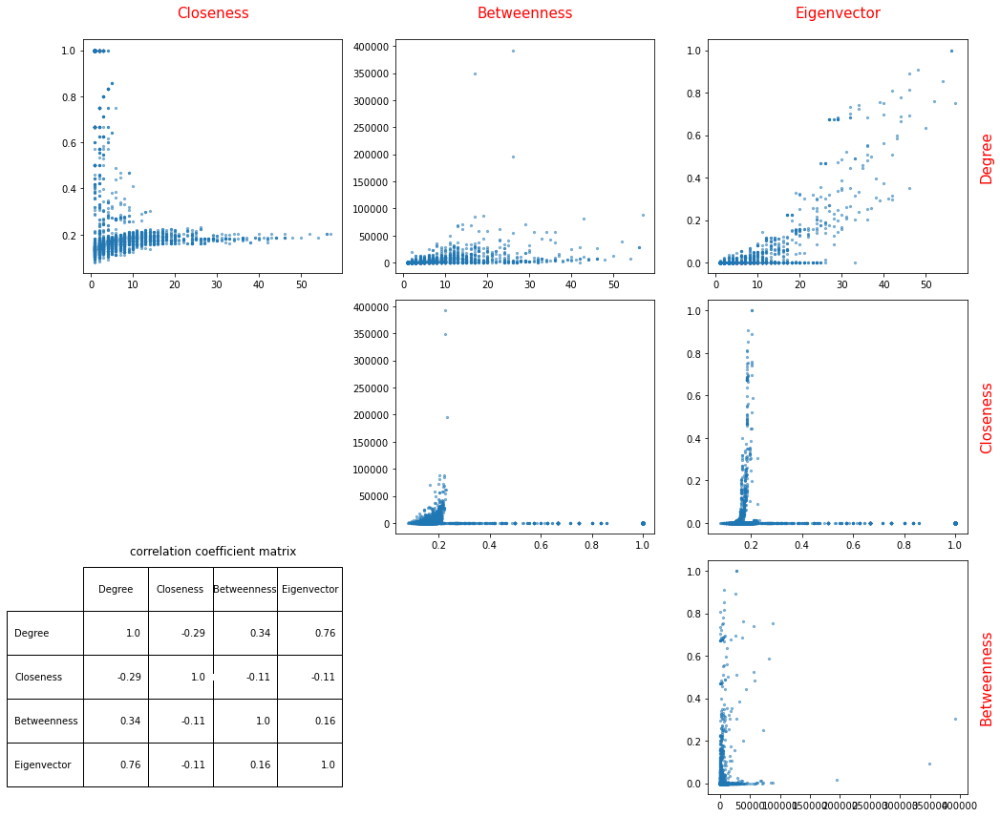

In [20]:
# calculate the correlation coefficient matrix the four different kinds of centralities.
centralities_corrcoef = centralities_correlation(mg)

## Correlation between Attributes and Centralities
<a id='attrs_centralities_corrcoef'></a>

From the figure [`Different centralities vs Movie Attributes`](#attrs_centralities_corrcoef), These attributes tend to have high centrality, e.g., **movies newest released**, **films with a length of 150 minutes**, and **movies with a rating of 6 ish**. Still, there is no significant relationship between the number of participants and centrality. From the performance of these centers, **degree** and **eigenvector** may be better indicators to evaluate the importance of our movie nodes.


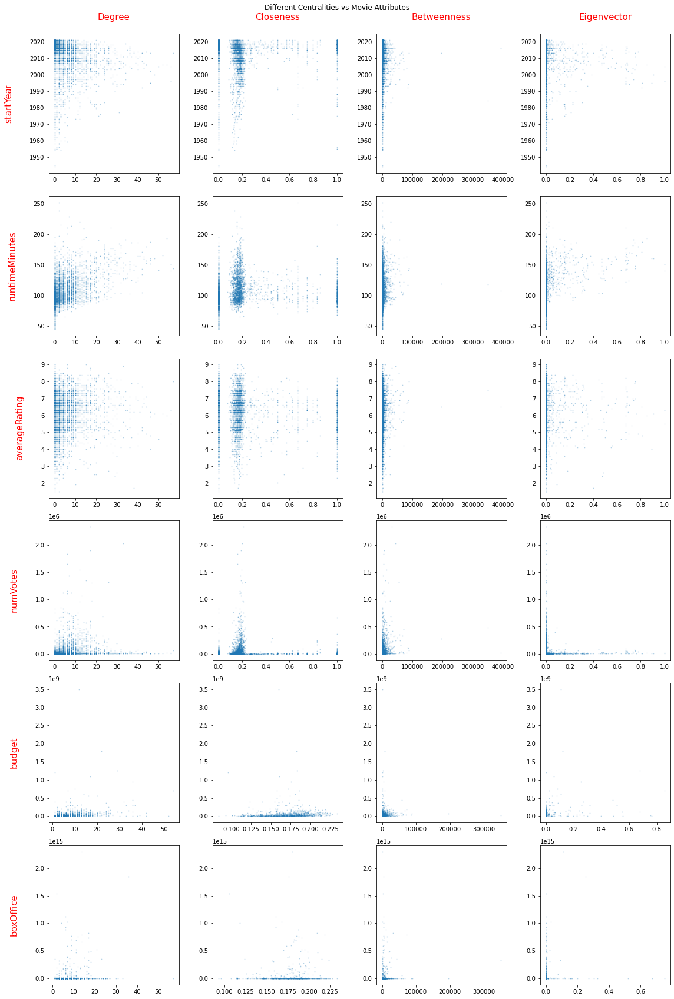

,startYear,runtimeMinutes,averageRating,numVotes,budget,boxOffice
Degree,-0.209465,0.448567,0.035565,0.201375,0.228645,0.108532
Closeness,0.013106,0.061342,-0.079857,0.002539,0.036777,0.003666
Betweenness,-0.083190,0.120900,0.051571,0.186572,0.009243,0.051831
Eigenvector,-0.128654,0.368387,-0.005924,-0.040007,0.257212,0.075730


In [21]:
attribute_with_centralities(mg, ['startYear', 'runtimeMinutes', 'averageRating', 'numVotes', 'budget', 'boxOffice'])

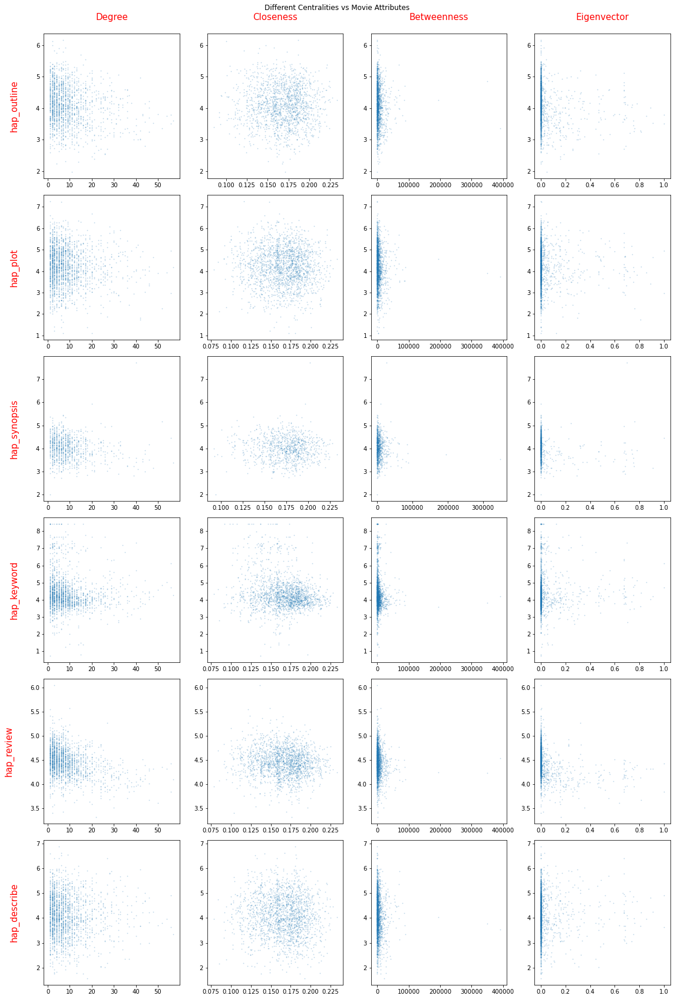

,hap_outline,hap_plot,hap_synopsis,hap_keyword,hap_review,hap_describe
Degree,-0.175066,-0.066066,-0.135135,-0.067313,-0.343942,-0.030128
Closeness,-0.008678,-0.039997,-0.020324,-0.196448,-0.084448,-0.061190
Betweenness,-0.027631,-0.047452,-0.063817,-0.059552,-0.074002,-0.053611
Eigenvector,-0.140777,-0.032536,-0.093624,0.036456,-0.291840,0.018561


In [22]:
attribute_with_centralities(mg, ['hap_outline', 'hap_plot', 'hap_synopsis', 'hap_keyword', 'hap_review', 'hap_describe'])

# Assortativity

## Numeric properties' Assortativity

In [23]:
numeric_asso = pd.DataFrame(index = ['Degree C', 'Closeness C', 'EigenVector C', 'StartYear', 'RuntimeMinutes', 
                                     'AverageRating', 'NumVotes', 'budget', 'boxOffice',
                                     'Outline', 'Plot', 'Synopsis', 'Keyword', 'Review', 'Describe'],
                            columns = ['Assortativity(fill zero)', 'Assortativity(drop null)'])

attr_name = ['dg', 'cn', 'ev', 'startYear', 'runtimeMinutes', 
             'averageRating', 'numVotes', 'budget', 'boxOffice', 
             'hap_outline', 'hap_plot', 'hap_synopsis', 'hap_keyword', 'hap_review', 'hap_describe']
# A easy to handle null values is to fill zeros.
for i, attr in enumerate(attr_name):
    try:
        asso = mg.assortativity(types1=attr, directed=False)
        if np.isnan(asso):
            types1 = np.nan_to_num(np.array(mg.vs[attr]).astype('float'))
            asso = mg.assortativity(types1=types1, directed=False)
    except ValueError:
        types1 = np.nan_to_num(np.array(mg.vs[attr]).astype('float'))
        asso = mg.assortativity(types1=types1, directed=False)
    numeric_asso.iloc[i, 0] = asso

# A better solution would be get the subgraph under given attribute  without nan values
for i, attr in enumerate(attr_name):
    vsId = np.argwhere(~pd.isna(mg.vs[attr]))[:,0]
    subg = mg.induced_subgraph(vsId)
    asso = subg.assortativity(types1=attr, directed=False)
    numeric_asso.iloc[i, 1] = asso

numeric_asso # turns out that the two results are similiar.

,Assortativity(fill zero),Assortativity(drop null)
Degree C,0.649301,0.649301
Closeness C,0.967309,0.967309
EigenVector C,0.78174,0.78174
StartYear,0.373413,0.373413
RuntimeMinutes,0.489719,0.51957
AverageRating,0.149727,0.141465
NumVotes,0.252769,0.252115
budget,0.048091,0.266301
boxOffice,0.034478,0.087302
Outline,0.409978,0.114584


## Nominal attributes' Assortativity

In [24]:
def list_add(a, b):
    try:
        return list(a) + list(b)
    except TypeError:
        return a  
country_types = set(reduce(list_add, mg.vs['country']))
genre_types = set(reduce(list_add, mg.vs['genres']))

In [25]:
country_assortativity = {}
for c in country_types:
    category_list = get_nominal(mg, 'country', c)
    country_assortativity[c] = mg.assortativity_nominal(types=category_list, directed=False)

country_asso_df = pd.DataFrame.from_dict(country_assortativity, orient='index').rename(columns = {0:'Assortativity'})
country_asso_df.sort_values('Assortativity', ascending=False).head(5)

,Assortativity
Kuwait,1.000000
Philippines,0.965793
India,0.951245
Egypt,0.919441
United States,0.826429


In [26]:
genre_assortativity = {}
for g in genre_types:
    category_list = get_nominal(mg, 'genres', g)
    genre_assortativity[g] = mg.assortativity_nominal(types=category_list, directed=False)

genre_asso_df = pd.DataFrame.from_dict(genre_assortativity, orient='index').rename(columns = {0:'Assortativity'})
genre_asso_df.sort_values('Assortativity', ascending=False).head(5)

,Assortativity
Documentary,0.235986
Comedy,0.227410
Animation,0.160078
Action,0.147193
Drama,0.139665


In [27]:
# save checkpoint
ig.Graph.write_pickle(mg, './netflix/network/netflix.movie.ig.pickle')

# Communities

## Communities detection

### Communities detection methods from `iGraph`

1. Community structure based on **the betweenness of the edges in the network**.

    > The idea is that the betweenness of the edges connecting two communities is typically high, as many of the shortest paths between nodes in separate communities go through them. So we gradually remove the edge with the highest betweenness and recalculate the betweennesses after every removal. This way sooner or later the network falls of to separate components. The result of the clustering will be represented by a dendrogram.
    
2. Community structure based on **the greedy optimization of modularity**.

    > This algorithm merges individual nodes into communities in a way that greedily maximizes the modularity score of the graph. It can be proven that if no merge can increase the current modularity score, the algorithm can be stopped since no further increase can be achieved. It runs almost in linear time on sparse graphs.
    
3. Community structure based on **the Infomap method of Martin Rosvall and Carl T. Bergstrom**.

    > The algorithm defines a attribute called `codelength`.
    
4. Community structure based on **the label propagation method of Raghavan et al**.

5. Community structure based on **Newman's leading eigenvector method**.

6. Community structure based on **the Leiden algorithm of Traag, van Eck & Waltman**.

7. Community structure based on **the multilevel algorithm of Blondel et al**.

    > It's a bottom-up algorithm, runs almost in linear time on sparse graphs.
    
8. Community structure based on **calculating the optimal modularity score of the graph**.

    > Unlikely to work for graphs larger than a few (less than a hundred) vertices, For a gigant network, use others instead.

9. Community structure based on **the spinglass community detection method of Reichardt & Bornholdt**.

10. Community structure based on **based on random walks**.

    > The basic idea of the algorithm is that short random walks tend to stay in the same community

11. Community structure based on **Louvain Algorithm**.
    
*some methods can return vertex dendrogram. and we only detect the communities inside the giant component GCC in our movie network.

In [151]:
# load checkpoint
mg = ig.Graph.Read_Pickle('./netflix/network/netflix.movie.ig.pickle')
gcc = mg.connected_components().giant()
print(gcc.summary(), '\n')
com_summary = pd.DataFrame(columns=['Cluster', 'Modularity', 'Top10_size'])

bt_dendrogram = gcc.community_edge_betweenness(directed=True) ## too slow
bt_clustering = bt_dendrogram.as_clustering() 
gcc.vs['bt_clustering'] = bt_clustering.membership
com_summary.loc['Edge Betweenness'] = [bt_clustering._len, bt_clustering.modularity, [i[1] for i in Counter(bt_clustering.membership).most_common(10)] ]

fg_dendrogram = gcc.community_fastgreedy()
fg_clustering = fg_dendrogram.as_clustering() 
gcc.vs['fg_clustering'] = fg_clustering.membership
com_summary.loc['Fast Greedy'] = [fg_clustering._len, fg_clustering.modularity, [i[1] for i in Counter(fg_clustering.membership).most_common(10)] ]

im_clustering = gcc.community_infomap()
gcc.vs['im_clustering'] = im_clustering.membership
com_summary.loc['InfoMap'] = [im_clustering._len, im_clustering.modularity, [i[1] for i in Counter(im_clustering.membership).most_common(10)] ]

ml_clustering = gcc.community_label_propagation()
gcc.vs['ml_clustering'] = ml_clustering.membership
com_summary.loc['Label Propagation'] = [ml_clustering._len, ml_clustering.modularity, [i[1] for i in Counter(ml_clustering.membership).most_common(10)] ]

try:
    ev_clustering = gcc.community_leading_eigenvector() # hard to converge, not stable, so catch the error and re do it.
except :
    ev_clustering = gcc.community_leading_eigenvector()
gcc.vs['ev_clustering'] = ev_clustering.membership
com_summary.loc['Leading Eigenvector'] = [ev_clustering._len, ev_clustering.modularity, [i[1] for i in Counter(ev_clustering.membership).most_common(10)] ]

ld_clustering = gcc.community_leiden(objective_function="modularity")
gcc.vs['ld_clustering'] = ld_clustering.membership
com_summary.loc['Leiden Algorithm'] = [ld_clustering._len, ld_clustering.modularity, [i[1] for i in Counter(ld_clustering.membership).most_common(10)] ]

lp_clustering = gcc.community_multilevel()
gcc.vs['lp_clustering'] = lp_clustering.membership
com_summary.loc['Multilevel Algorithm'] = [lp_clustering._len, lp_clustering.modularity, [i[1] for i in Counter(lp_clustering.membership).most_common(10)] ]

sl_clustering = gcc.community_spinglass()
gcc.vs['sl_clustering'] = sl_clustering.membership
com_summary.loc['Spinglass'] = [sl_clustering._len, sl_clustering.modularity, [i[1] for i in Counter(sl_clustering.membership).most_common(10)] ]

rw_clustering = gcc.community_walktrap().as_clustering() 
gcc.vs['rw_clustering'] = rw_clustering.membership
com_summary.loc['Random walks'] = [rw_clustering._len, rw_clustering.modularity, [i[1] for i in Counter(rw_clustering.membership).most_common(10)] ]

com_summary

IGRAPH U-W- 1923 8346 -- 
+ attr: averageRating (v), boxOffice (v), bt (v), budget (v), cn (v), country (v), description (v), dg (v), ev (v), genres (v), hap_describe (v), hap_keyword (v), hap_outline (v), hap_plot (v), hap_review (v), hap_synopsis (v), numVotes (v), primaryTitle (v), runtimeMinutes (v), startYear (v), tconst (v), weight (e), year (e) 



,Cluster,Modularity,Top10_size
Edge Betweenness,81,0.685408,"[369, 117, 86, 75, 72, 66, 62, 58, 56, 45]"
Fast Greedy,34,0.670547,"[402, 334, 289, 249, 225, 83, 39, 37, 37, 30]"
InfoMap,190,0.649736,"[36, 29, 28, 27, 26, 26, 26, 24, 23, 22]"
Label Propagation,168,0.654255,"[88, 76, 45, 37, 35, 32, 31, 30, 26, 24]"
Leading Eigenvector,81,0.646061,"[197, 188, 170, 157, 139, 135, 128, 112, 71, 71]"
Leiden Algorithm,24,0.728100,"[192, 175, 160, 153, 129, 120, 120, 94, 90, 79]"
Multilevel Algorithm,25,0.723510,"[238, 189, 152, 132, 123, 119, 101, 96, 89, 81]"
Spinglass,24,0.723702,"[182, 161, 141, 135, 128, 121, 105, 95, 89, 88]"
Random walks,177,0.652222,"[397, 243, 142, 70, 55, 47, 34, 31, 30, 22]"


### Community detections from package `leidenalg`

From table below, the Leiden algorithm and SpingLass algorithm have the smallest community amount and modularity values.

In [29]:
mg = ig.Graph.Read_Pickle('./netflix/network/netflix.movie.ig.pickle')
gcc = mg.connected_components().giant()
print(gcc.summary(), '\n')

# ref: https://leidenalg.readthedocs.io/en/stable/install.html
# this package have more free parmeter to tuning our communities, like fixed nodes, Maximum community size
p0 = la.find_partition(gcc, la.ModularityVertexPartition)
p1 = la.find_partition(gcc, la.RBConfigurationVertexPartition)
p2 = la.find_partition(gcc, la.RBERVertexPartition)
p3 = la.find_partition(gcc, la.CPMVertexPartition)
p4 = la.find_partition(gcc, la.SignificanceVertexPartition)
p5 = la.find_partition(gcc, la.SurpriseVertexPartition)
com_summary = pd.DataFrame(columns=['Cluster', 'Modularity', 'Top10_size'], 
                           index=['ModularityVertexPartition', 'RBConfigurationVertexPartition', 'RBERVertexPartition', 
                                  'CPMVertexPartition', 'SignificanceVertexPartition', 'SurpriseVertexPartition'])
parts = [p0, p1, p2, p3, p4, p5]
for i in range(6):
    com_summary.iloc[i] = [len(parts[i]), parts[i].modularity, [i[1] for i in Counter(parts[i].membership).most_common(10)] ]
    gcc.vs[f'p{i}_clustering'] = parts[i].membership
com_summary

IGRAPH U-W- 1923 8346 -- 
+ attr: averageRating (v), boxOffice (v), bt (v), budget (v), cn (v), country (v), description (v), dg (v), ev (v), genres (v), hap_describe (v), hap_keyword (v), hap_outline (v), hap_plot (v), hap_review (v), hap_synopsis (v), numVotes (v), primaryTitle (v), runtimeMinutes (v), startYear (v), tconst (v), weight (e), year (e) 



,Cluster,Modularity,Top10_size
ModularityVertexPartition,26,0.72817,"[213, 171, 151, 138, 118, 110, 102, 96, 88, 83]"
RBConfigurationVertexPartition,26,0.72817,"[213, 171, 151, 138, 118, 110, 102, 96, 88, 83]"
RBERVertexPartition,72,0.692389,"[372, 119, 90, 86, 83, 78, 75, 70, 68, 66]"
CPMVertexPartition,1923,-0.001,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]"
SignificanceVertexPartition,438,0.581306,"[28, 26, 19, 18, 17, 16, 15, 15, 15, 14]"
SurpriseVertexPartition,319,0.622315,"[43, 34, 29, 24, 21, 20, 17, 16, 16, 16]"


## Visualization

**Use plotly to visualize network, and we can pan, zoom and rotate the 3D figure.**

In [30]:
layouts = np.load('./netflix/network/movie.layout.npz')
fa3_layout = layouts['fa3d']
kk3_layout = layouts['kk3d']
fa2_layout = layouts['fa2d']
kk2_layout = layouts['kk2d']

### 3D interactive plot

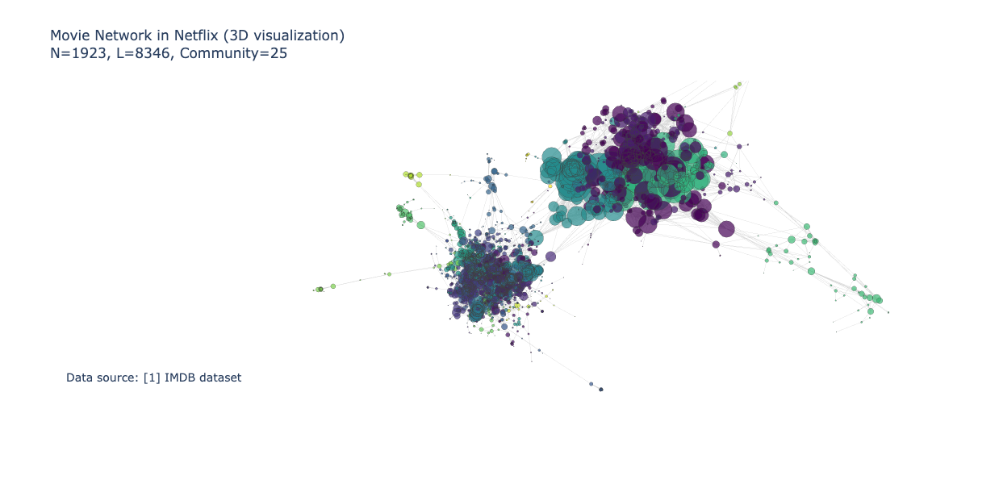

In [31]:
group_type = 'p0_clustering'  # set different community algor
layt = fa3_layout  # set different layout, kk and fa
size_type = 'dg' # 'bt', 'ev' try different centrality as the node size
plot_3d_graph(gcc, layt, size_type, group_type)

### 3D communities mapped graph
communities as nodes

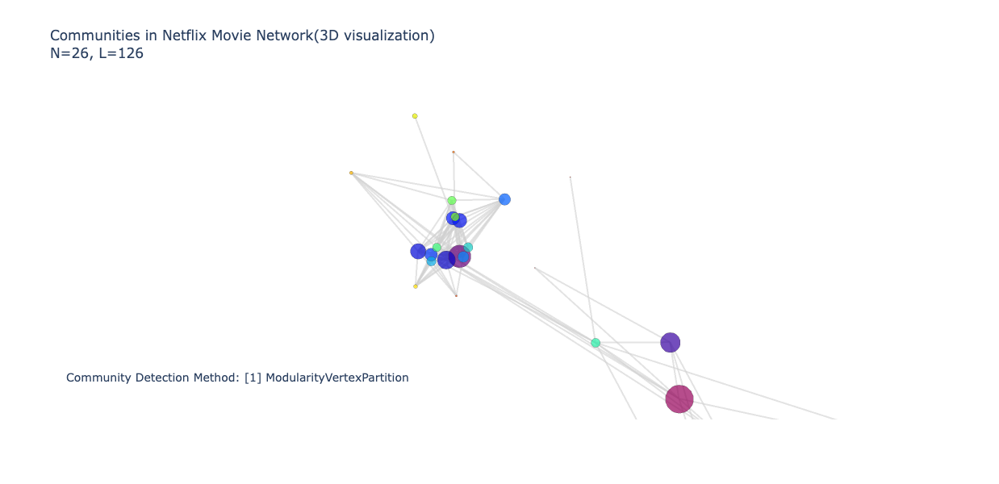

In [32]:
## plot the structure of communities
method = 'ModularityVertexPartition'
partition = p0
layt = fa3_layout
scale=10
plot_3d_communities(partition, layt, scale, method)

### 2D interactive plot

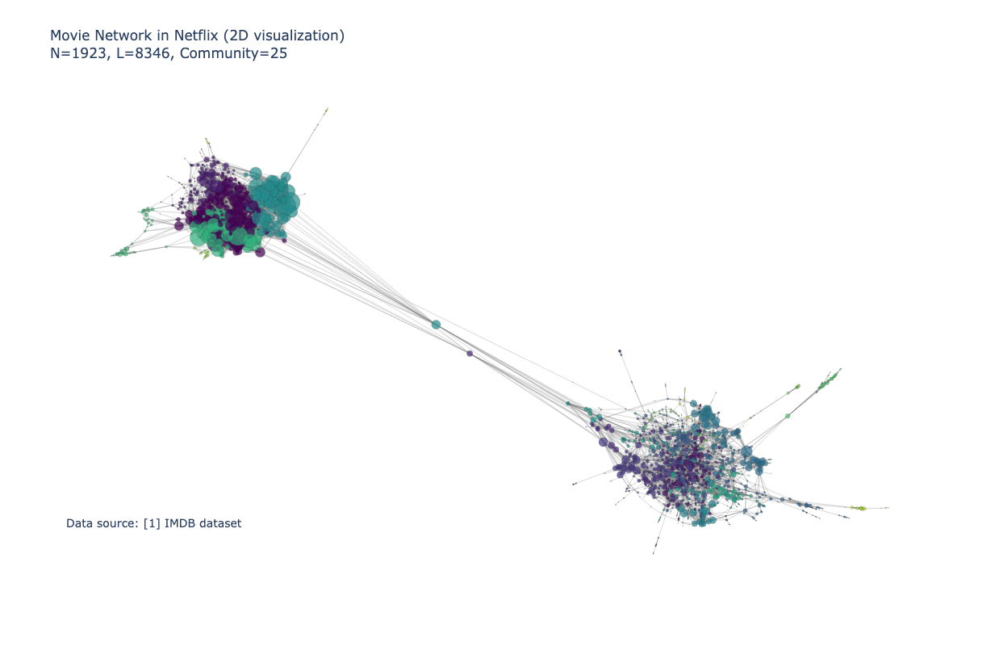

In [33]:
# graph setting
group_type = 'p0_clustering'  # set different community algor
layt = fa2_layout  # set different layout, kk and fa
size_type = 'dg' # 'bt', 'ev' try different centrality as the node size

plot_2d_graph(gcc, layt, size_type, group_type)

## TFIDF and WordCloud

we grabbed a lot movie text information, such as `keywords`, `plot`, `synopsis`, and `reviews`. we will plot wordcloud for each information category of each communites, then we do some comparison, and thus try to explain the differences and similarities between those information.

In [34]:
#  read movie keyword
labels = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']

m_attr = pd.read_csv('./netflix/download/movie.attr.csv', index_col=0)          # movie plot synopsis
m_keyword = pd.read_csv('./netflix/download/movie.keyword.csv', index_col=0)    # movie keywords
m_review = pd.read_csv('./netflix/download/movie.review.csv', index_col=0)      # movie reviews
m_describe = pd.read_parquet('./netflix/movie.parquet').set_index('tconst')

outline = m_attr.plotOutline.fillna('')
plot = m_attr.loc[:,'plot'].fillna('')
synopsis = m_attr.synopsis.fillna('')
keyword = m_keyword.keywords.fillna('')
review = m_review.reviews.fillna('')
describe = m_describe.loc[review.index].description.fillna('')

text_material = [outline, plot, synopsis, keyword, review, describe] 

In [35]:
limit = 20
partition = p0
wc_matrix = []
for label, text_series in zip(labels, text_material):
    # TF_IDF_vector for each communities
    keys, IDF = get_TFIDF(partition, text_series, label, limit) 
    wc_s = []
    for i in range(limit):
        vector ={ k:v for k, v in zip(keys, IDF[i].toarray()[0]) if v!=0 }
        wc = WordCloud(# font_path='/System/Library/Fonts/Supplemental/Arial Black.ttf', 
                    background_color='white',
                    width=600, contour_width=3, contour_color='steelblue',
                    height=300, stopwords=STOPWORDS, 
                    ).generate_from_frequencies(vector)
        wc_s.append(wc)
    wc_matrix.append(wc_s)

Pareparing Corpus for Movie plot outlines


100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 1977.84it/s]


Pareparing Corpus for Movie plots


100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 3550.58it/s]


Pareparing Corpus for Movie synopsis


100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 2441.96it/s]


Pareparing Corpus for Movie keywords


100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 2903.24it/s]


Pareparing Corpus for Movie reviews


100%|██████████████████████████████████████████| 20/20 [00:00<00:00, 414.59it/s]


Pareparing Corpus for Netflix Description


100%|█████████████████████████████████████████| 20/20 [00:00<00:00, 3457.08it/s]


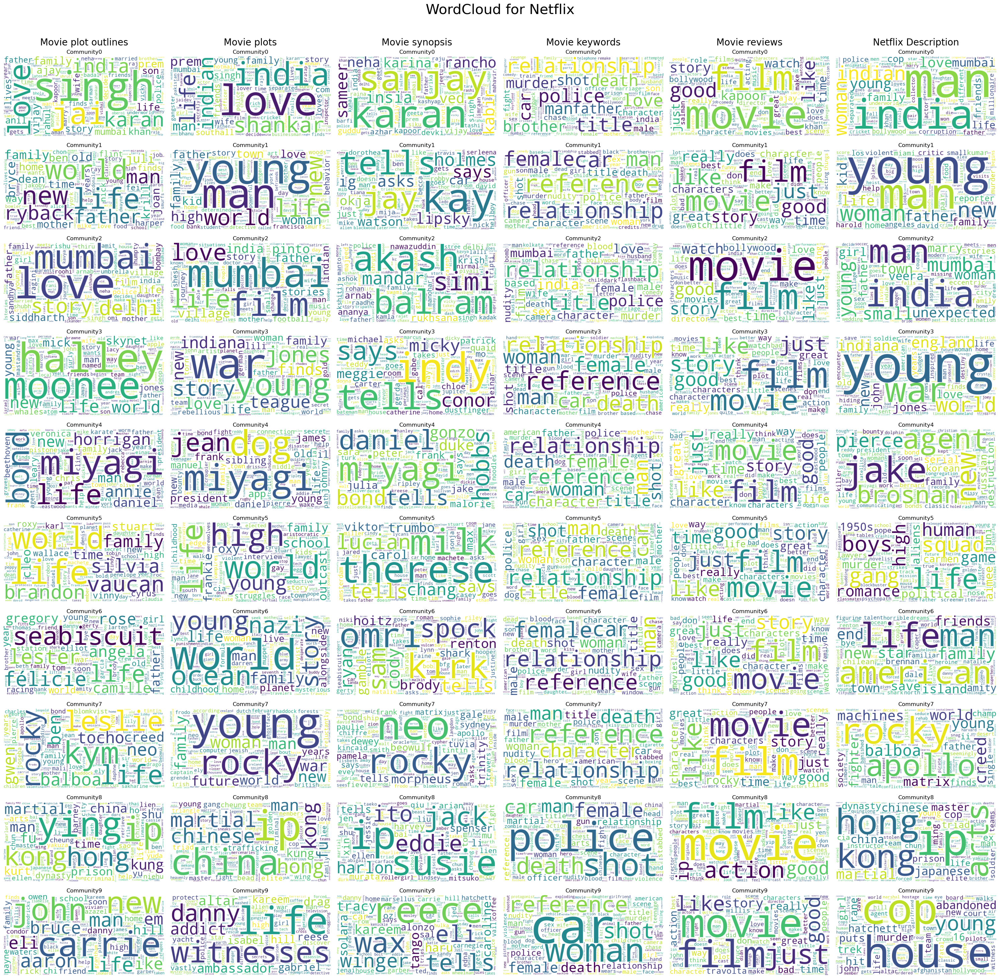

In [36]:
import matplotlib.pyplot as plt
limit = 10
names = np.array(Counter(gcc.vs['p0_clustering']).most_common(limit))[:, 0]
fig, axes = plt.subplots(limit, 6, figsize=(30, limit*3), dpi=100)
plt.suptitle('WordCloud for Netflix\n\n', size=30)
rows = [f"Community{i+1}" for i in range(limit)]
cols = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']
for ax, col in zip(axes[0], cols):
    ax.annotate(col, xy=(0.5, 1), xytext=(0, 20),
                xycoords='axes fraction', textcoords='offset points',
                size=20, ha='center', va='bottom', color='black')
for j in range(6):
    for i in range(limit):
        wc = wc_matrix[j][i]
        axes[i, j].imshow(wc)
        axes[i, j].set_axis_off()
        axes[i, j].set_title(f'Community{names[i]}')
plt.tight_layout()
plt.show()

## Attributes statistics for top communities

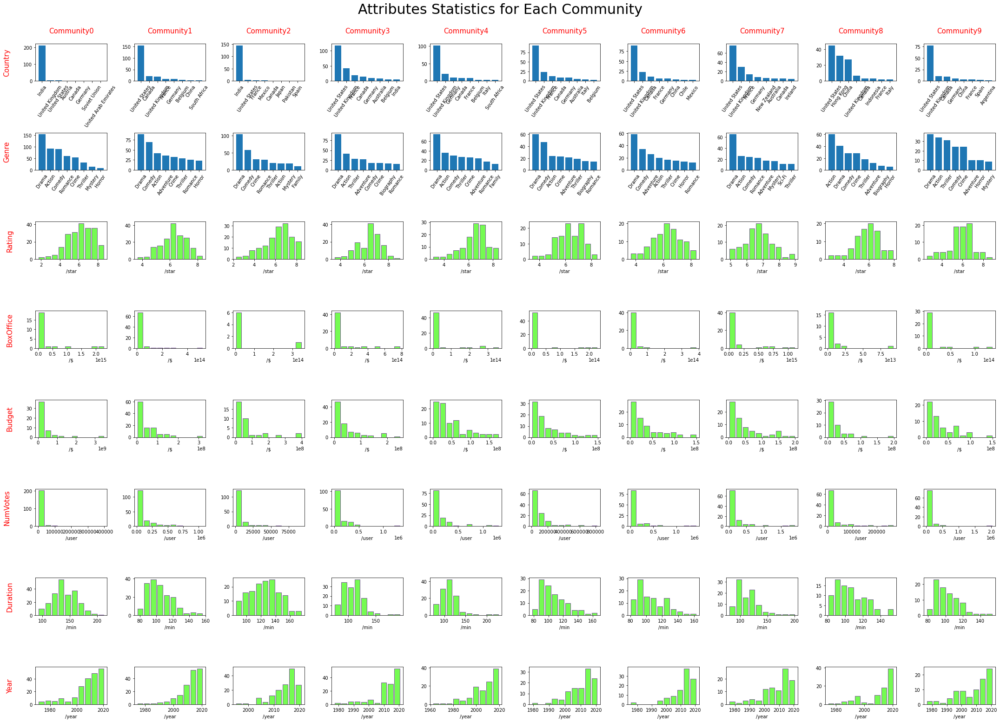

In [37]:
key = 'country'
limit = 10
names = np.array(Counter(gcc.vs['p0_clustering']).most_common(limit))[:, 0]
partition = p0
sub_graphs = sorted(partition.subgraphs(), key=lambda g: len(g.vs), reverse=True)[:limit]
fig, axes = plt.subplots(8, limit, figsize=(3*limit, 22))
plt.suptitle('Attributes Statistics for Each Community\n', size=30)
rows = ['Country', 'Genre', 'Rating', 'BoxOffice', 'Budget', 'NumVotes', 'Duration', 'Year']
cols = [f'Community{i}' for i in names]
axes = set_fig_info(fig, axes, rows, cols, direction='left')
x_label = ['/star', '/$', '/$', '/user', '/min', '/year']
for j, g in enumerate(sub_graphs):
    for i, key in enumerate(['country', 'genres']):
        noimal_list = np.hstack(g.vs[key])
        noimal_list = noimal_list[~pd.isna(noimal_list)]
        unique, counts = np.unique(noimal_list, return_counts=True)
        order = np.array(sorted(zip(unique, counts), key=lambda x:x[1], reverse=True))[:8]
        x = list(range(len(order)))
        axes[i, j].bar(x, order[:,1].astype('int'))
        axes[i, j].set_xticks(x, order[:,0], rotation=55)
    for i, key in enumerate(['averageRating', 'boxOffice', 'budget', 'numVotes', 'runtimeMinutes', 'startYear']):
        numerical_list = [i for i in g.vs[key] if not pd.isna(i)]
        axes[i+2, j].hist(numerical_list, rwidth=0.8, color='#75fb52', edgecolor='#7b549b')
        axes[i+2, j].set_xlabel(x_label[i])
plt.tight_layout()

There is no clear relation between the communities and movie attributes.

But we still found some interesting phonemon, for example, if a communities is dominated by Bollywood Movies(Hindu), there would be less movies from other country, which show inda movie market would be a relatively isolated market. On the contrary if a community is dominated by hollwoood movies there would be many other countries like Canada, UK, Australia, France, German incorporated with.

# Sentiment analysis

1. missing values of different text categories aren't synchronized.

In [38]:
haps_summary

,Movie plot outlines,Movie plots,Movie synopsis,Movie keywords,Movie reviews,Netflix Description
count,1628.000000,1918.000000,930.000000,1834.000000,1892.000000,1923.000000
mean,4.100989,4.222440,4.020640,4.367986,4.459886,4.098904
std,0.612063,0.869094,0.501581,0.986329,0.282609,0.814184
min,1.978065,1.100000,2.011618,0.740000,3.325590,1.571429
25%,3.671827,3.659118,3.689225,3.819650,4.283353,3.547560
50%,4.092577,4.226424,4.019557,4.176311,4.458642,4.084615
75%,4.537038,4.826429,4.343226,4.648746,4.632831,4.666857
max,6.156667,7.252000,7.710000,8.420000,6.053846,6.890000


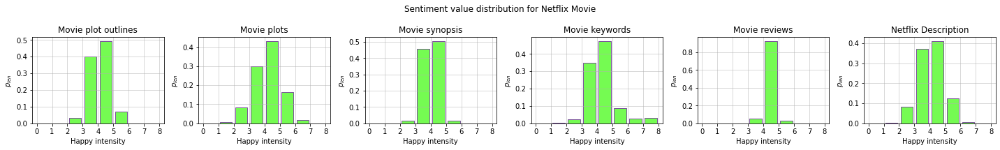

In [39]:
fig, axes = plt.subplots(1,6, figsize=(20, 3))
bins = range(9)

for ax, hap, title in zip(axes, haps, hap_titles):
    ax.set_title(f'{title}')
    ax.hist(hap.dropna(), bins, density=True, rwidth=0.8, color='#75fb52', edgecolor='#7b549b')
    ax.set_xlabel('Happy intensity')
    ax.set_ylabel('$p_{len}$')
    ax.grid(alpha=0.6)
    ax.set_xticks(bins)
plt.suptitle(f'Sentiment value distribution for Netflix Movie')
plt.tight_layout()
plt.show() 

## Sentiment for Countries and Genres

### Country

Top 10 most countries are  [('United States', 1108), ('India', 561), ('United Kingdom', 228), ('Canada', 126), ('France', 99), ('Germany', 73), ('China', 69), ('Hong Kong', 60), ('Spain', 54), ('Australia', 37)]


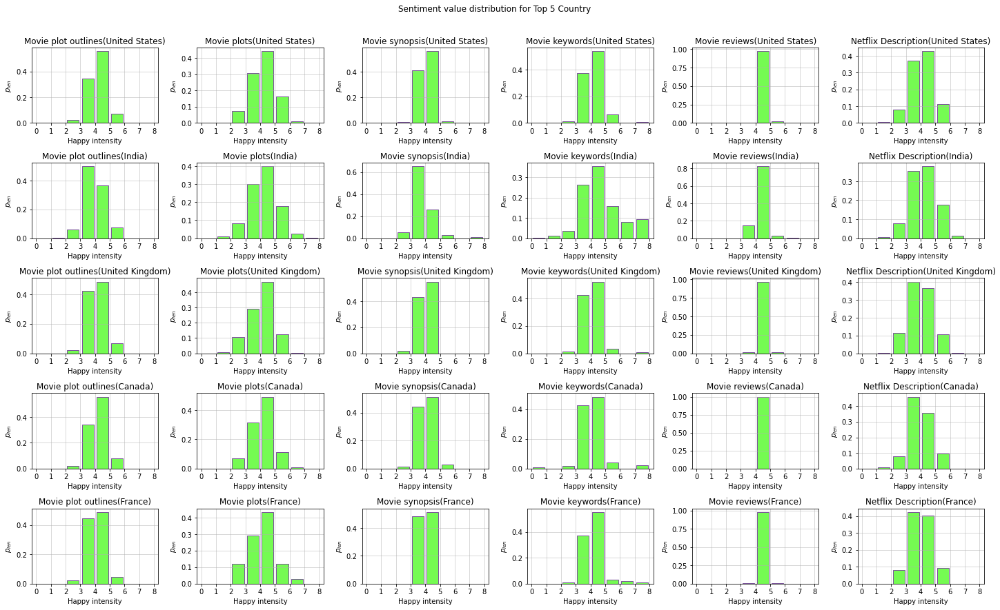

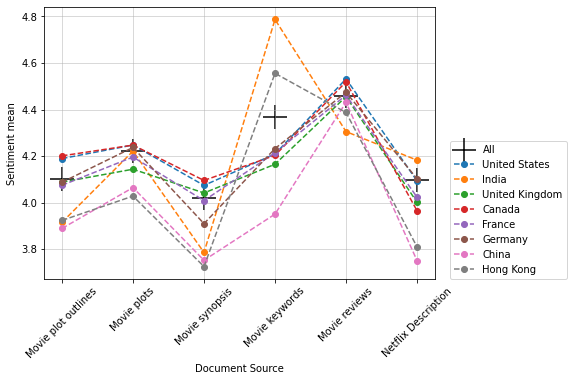

In [54]:
print('Top 10 most countries are ', 
      Counter(reduce(list_add, gcc.vs['country'])).most_common(10))
plot_hap_dist_for_attr(gcc, 'country', 5)

country_mean_dict, ax = plot_mean_dist_for_attr_x(gcc, 'country', 8, haps_summary)
#plot_mean_dist_for_attr_y(gcc, 'country', 8, haps_summary)

### Genres

Top 10 most genres are  [('Drama', 1120), ('Comedy', 690), ('Action', 570), ('Crime', 391), ('Thriller', 344), ('Romance', 328), ('Adventure', 269), ('Mystery', 161), ('Horror', 138), ('Biography', 132)]


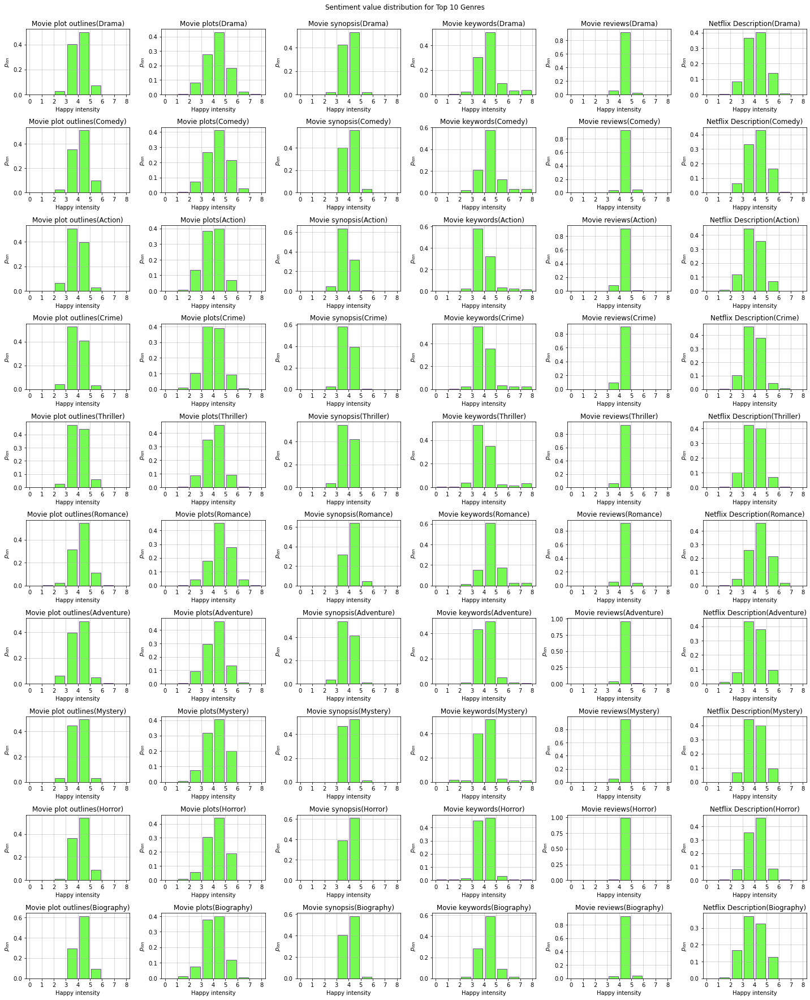

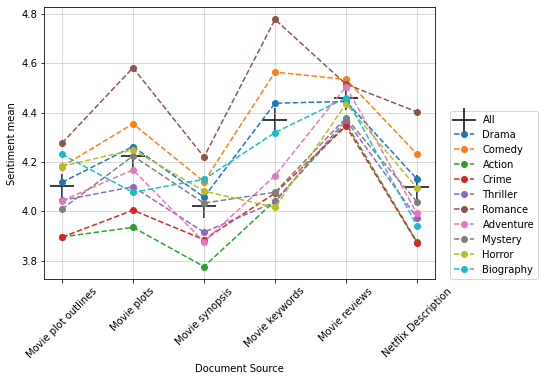

In [55]:
print('Top 10 most genres are ', 
      Counter(reduce(list_add, gcc.vs['genres'])).most_common(10))
plot_hap_dist_for_attr(gcc, 'genres', 10)

genres_means_dict, ax = plot_mean_dist_for_attr_x(gcc, 'genres', 10, haps_summary)
# plot_mean_dist_for_attr_y(gcc, 'genres', 10, haps_summary)

### Permutation Test for Some Genres

we found Romance movie always has a higher sentimental value than other movie.

Movie plot outlines           Movie plots            \
                        |Δ(mean)|   p-value   |Δ(mean)|   p-value   
United States           -0.088009  0.000999   -0.024863  0.214785   
France                  -0.026785  0.324675   -0.026835  0.412587   
China                    -0.21242  0.006993   -0.158102  0.063936   
India                   -0.186275  0.000999   -0.001372  0.496503   

              Movie synopsis           Movie keywords           Movie reviews  \
                   |Δ(mean)|   p-value      |Δ(mean)|   p-value     |Δ(mean)|   
United States      -0.053136  0.013986       -0.15946  0.000999      -0.07191   
France             -0.012411  0.415584      -0.153805  0.050949      -0.00212   
China              -0.268967  0.007992      -0.417791  0.000999     -0.028807   
India              -0.235373  0.000999       -0.41922  0.000999     -0.154817   

                        Netflix Description            
                p-value           |Δ(mean)|   p-value  
United States  0.000999           -0.005859  0.404595  
France         0.464535           -0.076295  0.183816  
China          0.224775           -0.348765  0.001998  
India          0.000999            -0.08323   0.01998

Movie plot outlines           Movie plots           Movie synopsis  \
                  |Δ(mean)|   p-value   |Δ(mean)|   p-value      |Δ(mean)|   
Romance           -0.175073  0.000999   -0.358978  0.000999      -0.199323   
Comedy            -0.079903  0.002997   -0.131889  0.000999      -0.099156   
Action            -0.205032  0.000999   -0.287711  0.000999      -0.244706   
Crime             -0.205822  0.000999   -0.218343  0.000999      -0.135655   

                  Movie keywords           Movie reviews            \
          p-value      |Δ(mean)|   p-value     |Δ(mean)|   p-value   
Romance  0.000999      -0.409134  0.000999     -0.054957  0.001998   
Comedy   0.002997      -0.195961  0.000999     -0.074126  0.000999   
Action   0.000999      -0.325202  0.000999     -0.103911  0.000999   
Crime    0.000999      -0.294547  0.000999     -0.114777  0.000999   

        Netflix Description            
                  |Δ(mean)|   p-value  
Romance           -0.303713  0.000999  
Comedy            -0.132746  0.000999  
Action            -0.223895  0.000999  
Crime             -0.226229  0.000999

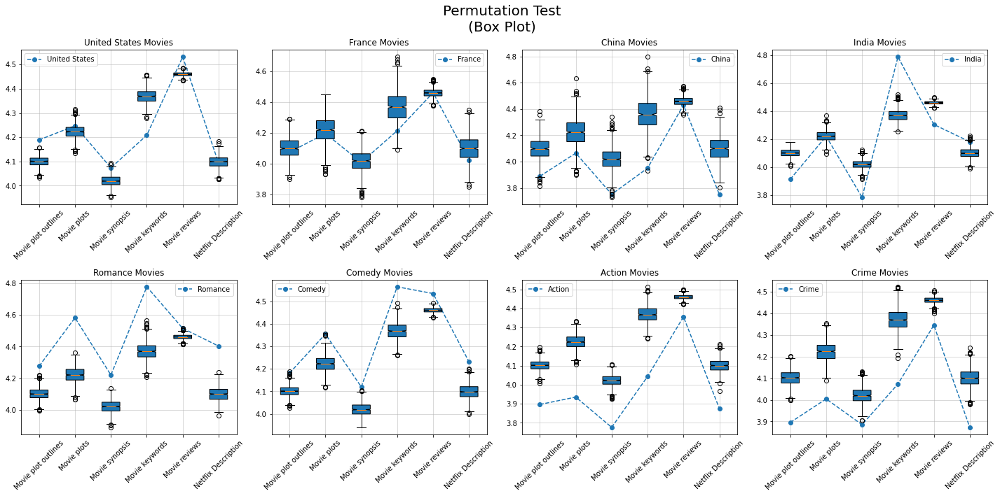

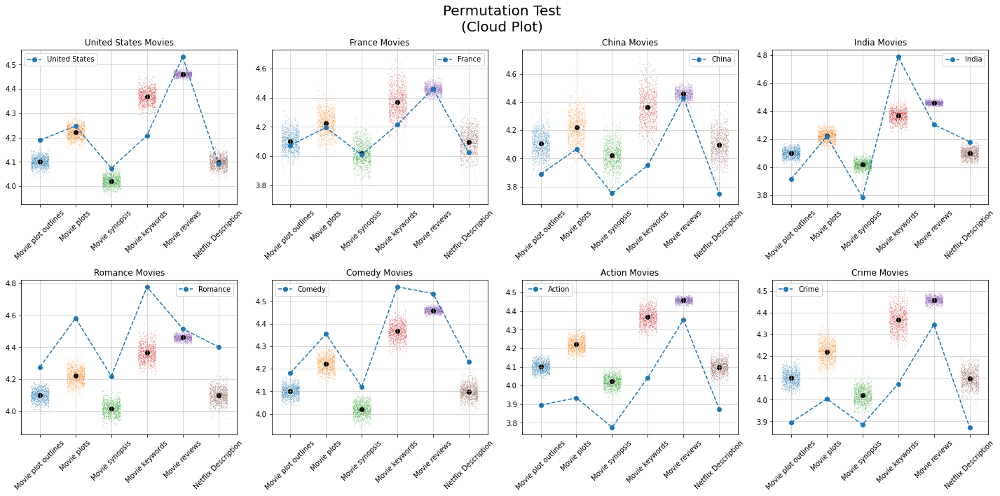

In [42]:
fig, axes = plt.subplots(2,4, figsize=(20, 10))
plt.suptitle('Permutation Test\n(Box Plot)', size=20)
columns = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']

countries = ['United States', 'France', 'China', 'India']
permutation_result = pd.DataFrame(index=countries, columns=pd.MultiIndex.from_product([columns, ['|Δ(mean)|', 'p-value']]))    
for ax, c in zip(axes[0], countries):
    ax, statistics = boxplot_for_perumtation(gcc, 'country', c, f'{c} Movies', 1000, ax)
    permutation_result.loc[c] = statistics
display(permutation_result)

genres = ['Romance', 'Comedy', 'Action', 'Crime']
permutation_result = pd.DataFrame(index=genres, columns=pd.MultiIndex.from_product([columns, ['|Δ(mean)|', 'p-value']]))    
for ax, r in zip(axes[1], genres):
    ax, statistics = boxplot_for_perumtation(gcc, 'genres', r, f'{r} Movies', 1000, ax)
    permutation_result.loc[r] = statistics
display(permutation_result)

plt.tight_layout()
plt.show() 

fig, axes = plt.subplots(2,4, figsize=(20, 10))
plt.suptitle('Permutation Test\n(Cloud Plot)', size=20)

countries = ['United States', 'France', 'China', 'India']
for ax, c in zip(axes[0], countries):
    ax = cloudplot_for_perumtation(gcc, 'country', c, f'{c} Movies', 1000, ax)
genres = ['Romance', 'Comedy', 'Action', 'Crime']
for ax, r in zip(axes[1], genres):
    ax = cloudplot_for_perumtation(gcc, 'genres', r, f'{r} Movies', 1000, ax)
plt.tight_layout()
plt.show() 

## Sentiment for Communities

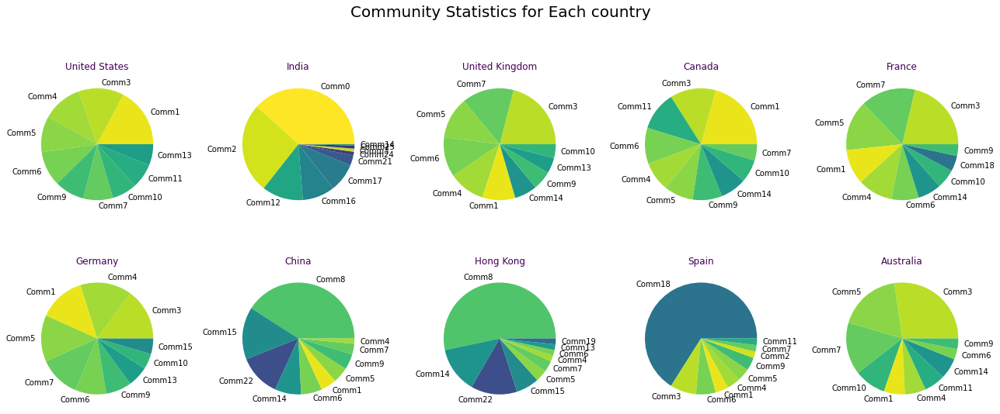

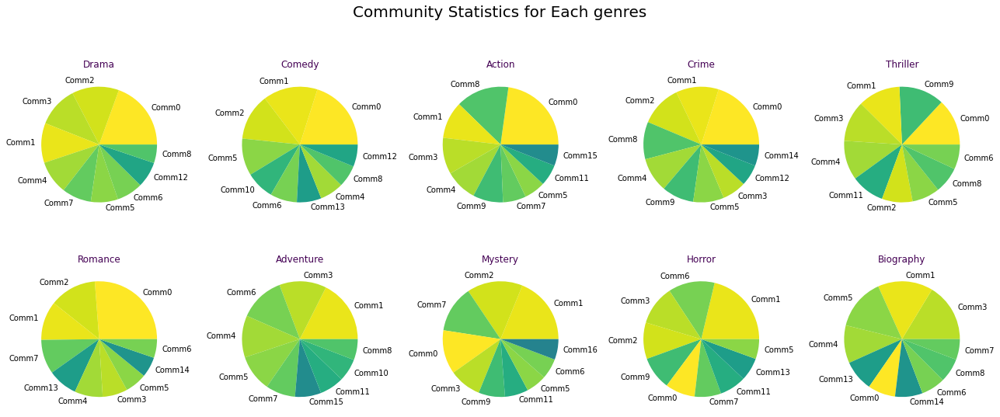

In [43]:
from SN_help import get_nominal
import matplotlib as mpl
cmap = mpl.colormaps['viridis']
colors = cmap(np.linspace(0,1, 30))[::-1]
limit = 10
partition = p0
part_key = 'p0_clustering'
attr_key = 'country'
g = gcc
member_list = np.array(g.vs[part_key])
attr_types = Counter(reduce(list_add, g.vs[attr_key])).most_common(limit)
fig, axes = plt.subplots(2, 5, figsize=(18, 8))
plt.suptitle(f'Community Statistics for Each {attr_key}\n', size=20)
for i, (k, v) in enumerate(attr_types):
    attr_list = np.array(get_nominal(g, attr_key, k))
    assert len(member_list) == len(attr_list)
    member_of_attr = member_list[attr_list == 1]
    member_of_attr = member_of_attr[~pd.isna(member_of_attr)]
    unique, counts = np.unique(member_of_attr, return_counts=True)
    order = np.array(sorted(zip(unique, counts), key=lambda x:x[1], reverse=True))[:10]
    x = range(len(order))
    # axes[i//5, i%5].bar(x, order[:,1].astype('int'))
    # axes[i//5, i%5].set_xticks(x, [f'C{i}' for i in order[:,0]], rotation=55)
    axes[i//5, i%5].pie(order[:,1].astype('int'), labels=[f'Comm{i}' for i in order[:,0]], colors=colors[order[:,0]])
    axes[i//5, i%5].set_title(f'{k}', color=colors[-1])
plt.tight_layout()
plt.show()

limit = 10
partition = p0
part_key = 'p0_clustering'
attr_key = 'genres'
g = gcc
member_list = np.array(g.vs[part_key])
attr_types = Counter(reduce(list_add, g.vs[attr_key])).most_common(limit)
fig, axes = plt.subplots(2, 5, figsize=(18, 8))
plt.suptitle(f'Community Statistics for Each {attr_key}\n', size=20)
for i, (k, v) in enumerate(attr_types):
    attr_list = np.array(get_nominal(g, attr_key, k))
    assert len(member_list) == len(attr_list)
    member_of_attr = member_list[attr_list == 1]
    member_of_attr = member_of_attr[~pd.isna(member_of_attr)]
    unique, counts = np.unique(member_of_attr, return_counts=True)
    order = np.array(sorted(zip(unique, counts), key=lambda x:x[1], reverse=True))[:10]
    x = range(len(order))
    axes[i//5, i%5].pie(order[:,1].astype('int'), labels=[f'Comm{i}' for i in order[:,0]], colors=colors[order[:,0]])
    # axes[i//5, i%5].bar(x, order[:,1].astype('int'))
    # axes[i//5, i%5].set_xticks(x, [f'C{i}' for i in order[:,0]], rotation=55)
    axes[i//5, i%5].set_title(f'{k}', color=colors[-1])
plt.tight_layout()
plt.show()

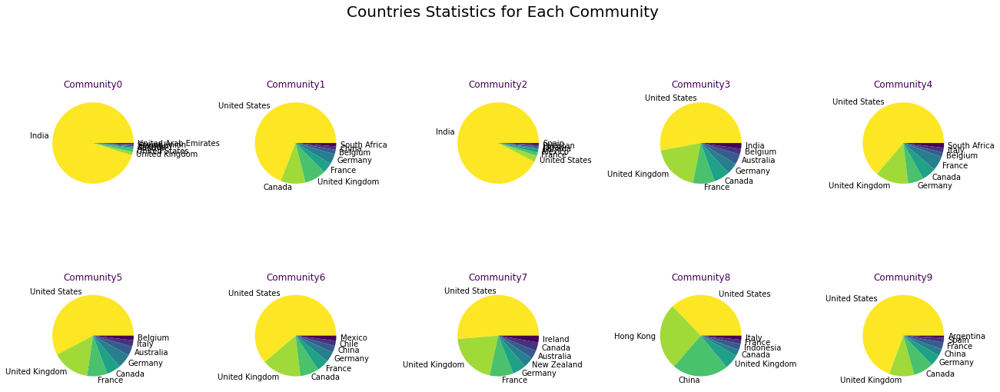

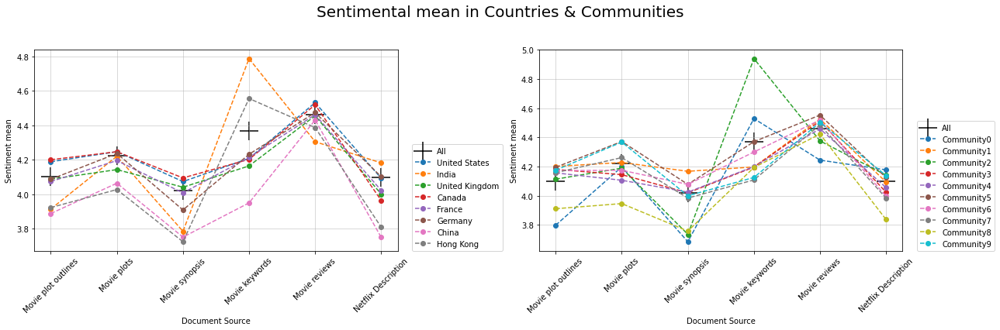

In [56]:
limit = 10
names = np.array(Counter(gcc.vs['p0_clustering']).most_common(limit))[:, 0]
partition = p0
colors = cmap(np.linspace(0,1, 8))[::-1]
sub_graphs = sorted(partition.subgraphs(), key=lambda g: len(g.vs), reverse=True)[:limit]
fig, axes = plt.subplots(2, 5, figsize=(18, 8))
plt.suptitle('Countries Statistics for Each Community\n', size=20)
for i, g in enumerate(sub_graphs):
    country_list = np.hstack(g.vs['country'])
    country_list = country_list[~pd.isna(country_list)]
    unique, counts = np.unique(country_list, return_counts=True)
    order = np.array(sorted(zip(unique, counts), key=lambda x:x[1], reverse=True))[:8]
    x = range(len(order))
    axes[i//5, i%5].pie(order[:,1].astype('int'), labels=order[:,0], colors=colors)
    # axes[i//5, i%5].bar(x, order[:,1].astype('int'))
    # axes[i//5, i%5].set_xticks(x, order[:,0], rotation=55)
    axes[i//5, i%5].set_title(f'Community{names[i]}', color=colors[-1])
plt.tight_layout()
plt.show()

fig, (ax0, ax1) = plt.subplots(1,2, figsize=(18, 6))
plt.suptitle('Sentimental mean in Countries & Communities\n', size=20)
country_means_dict, _ = plot_mean_dist_for_attr_x(gcc, 'country', 8, haps_summary, ax0)
community_means_dict, _ = plot_mean_dist_for_community_x(gcc, 'p0_clustering', 10, haps_summary, ax1)
plt.tight_layout()
plt.show()

From visual inspection, we found the two figures above have a strong similarity, which inspire us that there maybe strong relationship between communities and countries.

### T-test between community and country

**India movie and community-0**

Movie plot outlines  :  (0.04387735187817556, 'Reject')
Movie plots          :  (0.7583302154308291, 'Accept')
Movie synopsis       :  (0.20344531802044352, 'Accept')
Movie keywords       :  (0.024588323226711284, 'Reject')
Movie reviews        :  (0.010256176157135834, 'Reject')
Netflix Description  :  (0.948440183966653, 'Accept')


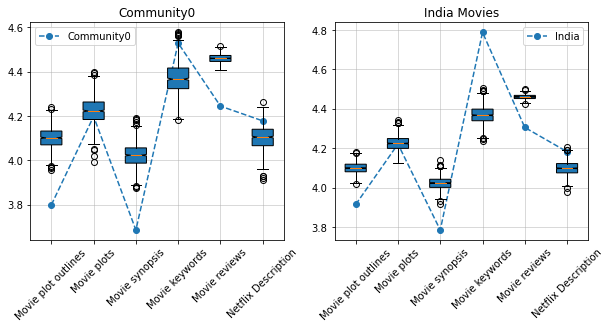

In [45]:
columns = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']
India_list = get_attr_hap(gcc, 'country', 'India')
Community = get_comm_hap(gcc, 'p0_clustering', 0)
for i in range(6):
    print(f'{columns[i]:<19}', ' : ',ttest_ind_fun(India_list[i], Community[i]))

fig, (ax0, ax1) = plt.subplots(1,2, figsize=(10, 4))
boxplot_for_perumtation_community(gcc, 'p0_clustering', 0, 'Community0', 1000, ax0)
boxplot_for_perumtation(gcc, 'country', 'India', f'India Movies', 1000, ax1)
plt.show()

**India movie and community-2**

Movie plot outlines  :  (0.004210479952894365, 'Reject')
Movie plots          :  (0.704788059088357, 'Accept')
Movie synopsis       :  (0.6739517146663029, 'Accept')
Movie keywords       :  (0.28865509524488925, 'Accept')
Movie reviews        :  (0.020296500001614794, 'Reject')
Netflix Description  :  (0.6075827002376644, 'Accept')


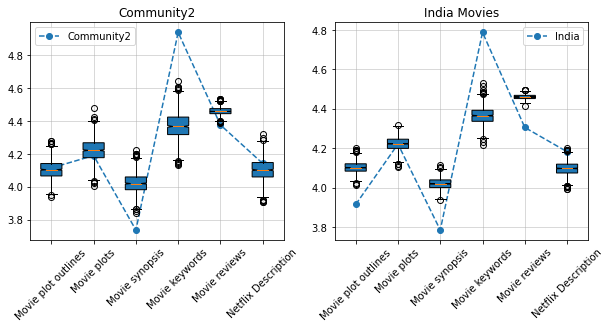

In [46]:
columns = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']
India_list = get_attr_hap(gcc, 'country', 'India')
Community = get_comm_hap(gcc, 'p0_clustering', 2)
for i in range(6):
    print(f'{columns[i]:<19}', ' : ',ttest_ind_fun(India_list[i], Community[i]))

fig, (ax0, ax1) = plt.subplots(1,2, figsize=(10, 4))
boxplot_for_perumtation_community(gcc, 'p0_clustering', 2, 'Community2', 1000, ax0)
boxplot_for_perumtation(gcc, 'country', 'India', f'India Movies', 1000, ax1)
plt.show()

**Spain and Community-17**

Movie plot outlines  :  (0.9886123030589846, 'Accept')
Movie plots          :  (0.5143033381047091, 'Accept')
Movie synopsis       :  (0.14457472980506061, 'Accept')
Movie keywords       :  (2.098675002399134e-06, 'Reject')
Movie reviews        :  (0.08375373928624479, 'Accept')
Netflix Description  :  (0.009360164199289669, 'Reject')


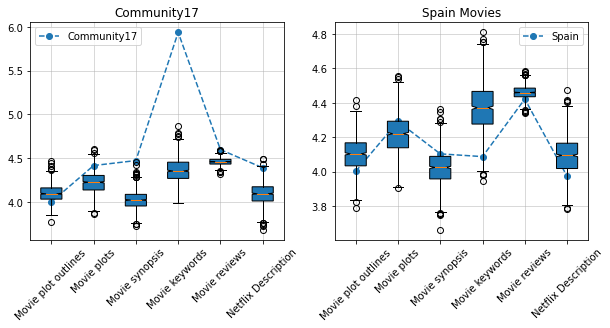

In [47]:
columns = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']
Spain_list = get_attr_hap(gcc, 'country', 'Spain')
Community = get_comm_hap(gcc, 'p0_clustering', 17)
for i in range(6):
    print(f'{columns[i]:<19}', ' : ',ttest_ind_fun(Spain_list[i], Community[i]))

fig, (ax0, ax1) = plt.subplots(1,2, figsize=(10, 4))
boxplot_for_perumtation_community(gcc, 'p0_clustering', 17, 'Community17', 1000, ax0)
boxplot_for_perumtation(gcc, 'country', 'Spain', f'Spain Movies', 1000, ax1)
plt.show()

**HK(China) and Community-9**

Movie plot outlines  :  (0.014023835746954948, 'Reject')
Movie plots          :  (0.029651788949040372, 'Reject')
Movie synopsis       :  (0.041170213434353044, 'Reject')
Movie keywords       :  (0.05502682514902174, 'Accept')
Movie reviews        :  (0.003976674365685077, 'Reject')
Netflix Description  :  (0.00676183153841699, 'Reject')


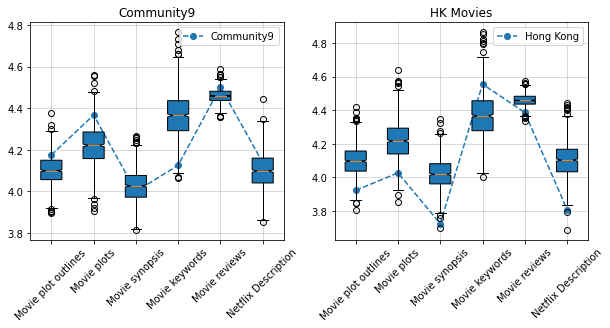

In [48]:
columns = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']
HK_list = get_attr_hap(gcc, 'country', 'Hong Kong')
Community = get_comm_hap(gcc, 'p0_clustering', 9)
for i in range(6):
    print(f'{columns[i]:<19}', ' : ',ttest_ind_fun(HK_list[i], Community[i]))

fig, (ax0, ax1) = plt.subplots(1,2, figsize=(10, 4))
boxplot_for_perumtation_community(gcc, 'p0_clustering', 9, 'Community9', 1000, ax0)
boxplot_for_perumtation(gcc, 'country', 'Hong Kong', f'HK Movies', 1000, ax1)
plt.show()

**China and Hong Kong(China)**

Movie plot outlines  :  (0.7690544066843771, 'Accept')
Movie plots          :  (0.8195297605495346, 'Accept')
Movie synopsis       :  (0.807216028441694, 'Accept')
Movie keywords       :  (0.009502611562633179, 'Reject')
Movie reviews        :  (0.3141151145471103, 'Accept')
Netflix Description  :  (0.6485067831798761, 'Accept')


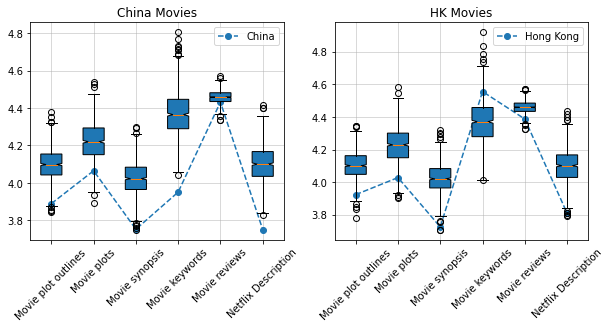

In [49]:
columns = ['Movie plot outlines', 'Movie plots', 'Movie synopsis', 'Movie keywords', 'Movie reviews', 'Netflix Description']
China_list = get_attr_hap(gcc, 'country', 'China')
HK_list = get_attr_hap(gcc, 'country', 'Hong Kong')
for i in range(6):
    print(f'{columns[i]:<19}', ' : ',ttest_ind_fun(China_list[i], HK_list[i]))

fig, (ax0, ax1) = plt.subplots(1,2, figsize=(10, 4))
boxplot_for_perumtation(gcc, 'country', 'China', f'China Movies', 1000, ax0)
boxplot_for_perumtation(gcc, 'country', 'Hong Kong', f'HK Movies', 1000, ax1)
plt.show()

### Calculate correlation coefficients and MSError of mean values from different text type between communities and countries

In [57]:
corrcoef_df = pd.DataFrame(index=country_means_dict.keys(), columns=community_means_dict.keys())
for country, v in country_means_dict.items():
    for community, u in community_means_dict.items():
        corrcoef = np.corrcoef(v, u)[0,1]
        corrcoef_df.loc[country, community] = corrcoef
display(corrcoef_df)

print('Community-Country Pairs with highest Corrcoef')
for community, corrcoef0 in corrcoef_df.max(axis=0).iteritems():
    for country, corrcoef1 in corrcoef_df.max(axis=1).iteritems():
        if corrcoef0 == corrcoef1:
            print(community, ' ~ ',  country)

error_df = pd.DataFrame(index=country_means_dict.keys(), columns=community_means_dict.keys())
for country, v in country_means_dict.items():
    for community, u in community_means_dict.items():
        error = np.linalg.norm(np.subtract(u, v))
        error_df.loc[country, community] = error
display(error_df)

print('Community-Country Pairs with lowest MSE')
for community, error0 in error_df.min(axis=0).iteritems():
    for country, error1 in error_df.min(axis=1).iteritems():
        if error0 == error1:
            print(community, ' ~ ',  country)

,0,1,2,3,4,5,6,7,8,9
United States,0.400207,0.97001,0.374519,0.97988,0.959835,0.92715,0.93463,0.973501,0.905607,0.907274
India,0.968386,0.185819,0.966574,0.358689,0.412128,0.616717,0.478284,0.2491,0.655802,0.258375
United Kingdom,0.405484,0.980534,0.402535,0.977333,0.966137,0.918215,0.968489,0.930792,0.93191,0.827653
Canada,0.267349,0.961828,0.323691,0.951476,0.909386,0.895606,0.950731,0.959152,0.852255,0.823882
France,0.561221,0.929205,0.526464,0.951886,0.942195,0.975137,0.956239,0.928394,0.955637,0.860415
Germany,0.694288,0.814989,0.609342,0.88951,0.889416,0.961503,0.854891,0.889042,0.921565,0.900927
China,0.417307,0.959939,0.367404,0.954415,0.924759,0.94639,0.922982,0.982264,0.886315,0.925219
Hong Kong,0.811364,0.563582,0.91793,0.708092,0.736615,0.834933,0.821375,0.574902,0.89536,0.466416


Community-Country Pairs with highest Corrcoef
0  ~  India
1  ~  United Kingdom
3  ~  United States
5  ~  France
7  ~  China


,0,1,2,3,4,5,6,7,8,9
United States,0.705672,0.097358,0.826654,0.13714,0.173858,0.207455,0.152871,0.182226,0.587027,0.172845
India,0.307837,0.79514,0.269704,0.740624,0.716522,0.651943,0.687157,0.795416,0.749021,0.784003
United Kingdom,0.648894,0.224851,0.849312,0.117181,0.103592,0.363024,0.178194,0.162603,0.422293,0.286987
Canada,0.747668,0.149641,0.856502,0.141643,0.196885,0.265358,0.129359,0.157152,0.559446,0.246253
France,0.591973,0.227583,0.788964,0.129602,0.128144,0.305294,0.161647,0.158375,0.432755,0.250638
Germany,0.530317,0.289104,0.737395,0.19591,0.196702,0.28971,0.239457,0.201476,0.460666,0.215982
China,0.763015,0.696612,1.095401,0.553072,0.552219,0.791065,0.624188,0.498259,0.285256,0.64996
Hong Kong,0.450292,0.736126,0.565265,0.59834,0.585915,0.690999,0.571378,0.645987,0.375443,0.749564


Community-Country Pairs with lowest MSE
1  ~  United States
2  ~  India
4  ~  United Kingdom
6  ~  Canada
8  ~  China
